# Importing modules and setting

In [1]:
import pandas as pd
import random
import math
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder

In [2]:
def seed_everything(seed):
    random.seed(seed) #파이썬 자체 모듈 random 모듈의 시드 고정
    os.environ['PYTHONHASHSEED'] = str(seed) 
    np.random.seed(seed)
    
seed_everything(37)

In [3]:
# 한글 폰트 설정
import matplotlib.pyplot as plt
import platform

path = "c:/Windows/Fonts/malgun.ttf"
from matplotlib import font_manager, rc

if platform.system() == 'Darwin':
    plt.rcParams["font.family"] = 'AppleGothic'

elif platform.system() == 'Windows':
    font_name = font_manager.FontProperties(fname=path).get_name()
    plt.rcParams["font.family"] = font_name
elif platform.system() == 'Linux':
    plt.rcParams['font.family'] = 'NanumGothic'


plt.rcParams['axes.unicode_minus'] = False

# Importing data

In [4]:
train = pd.read_csv('./data/train.csv')
test = pd.read_csv('./data/test.csv')

# EDA

## 데이터 확인

In [5]:
train.head()

,PRODUCT_ID,Y_Class,Y_Quality,TIMESTAMP,LINE,PRODUCT_CODE,X_1,X_2,X_3,X_4,...,X_2866,X_2867,X_2868,X_2869,X_2870,X_2871,X_2872,X_2873,X_2874,X_2875
0,TRAIN_000,1,0.533433,2022-06-13 5:14,T050304,A_31,NaN,NaN,NaN,NaN,...,39.34,40.89,32.56,34.09,77.77,NaN,NaN,NaN,NaN,NaN
1,TRAIN_001,2,0.541819,2022-06-13 5:22,T050307,A_31,NaN,NaN,NaN,NaN,...,38.89,42.82,43.92,35.34,72.55,NaN,NaN,NaN,NaN,NaN
2,TRAIN_002,1,0.531267,2022-06-13 5:30,T050304,A_31,NaN,NaN,NaN,NaN,...,39.19,36.65,42.47,36.53,78.35,NaN,NaN,NaN,NaN,NaN
3,TRAIN_003,2,0.537325,2022-06-13 5:39,T050307,A_31,NaN,NaN,NaN,NaN,...,37.74,39.17,52.17,30.58,71.78,NaN,NaN,NaN,NaN,NaN
4,TRAIN_004,1,0.531590,2022-06-13 5:47,T050304,A_31,NaN,NaN,NaN,NaN,...,38.70,41.89,46.93,33.09,76.97,NaN,NaN,NaN,NaN,NaN


In [6]:
test.head()

,PRODUCT_ID,TIMESTAMP,LINE,PRODUCT_CODE,X_1,X_2,X_3,X_4,X_5,X_6,...,X_2866,X_2867,X_2868,X_2869,X_2870,X_2871,X_2872,X_2873,X_2874,X_2875
0,TEST_000,2022-09-09 2:01,T100306,T_31,2.0,94.0,0.0,45.0,10.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,TEST_001,2022-09-09 2:09,T100304,T_31,2.0,93.0,0.0,45.0,11.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,TEST_002,2022-09-09 8:42,T100304,T_31,2.0,95.0,0.0,45.0,11.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,TEST_003,2022-09-09 10:56,T010305,A_31,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,TEST_004,2022-09-09 11:04,T010306,A_31,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
train.describe()

,Y_Class,Y_Quality,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,...,X_2866,X_2867,X_2868,X_2869,X_2870,X_2871,X_2872,X_2873,X_2874,X_2875
count,598.000000,598.000000,349.000000,349.000000,349.0,349.0,349.000000,349.0,349.000000,349.000000,...,100.000000,100.00000,100.000000,100.000000,100.00000,99.0,0.0,0.0,0.0,0.0
mean,1.025084,0.530896,2.409742,95.123209,0.0,45.0,10.392550,0.0,48.802292,10.048711,...,50.807300,53.60770,49.606200,51.659800,66.64970,1.0,NaN,NaN,NaN,NaN
std,0.565069,0.007401,5.895256,4.107640,0.0,0.0,0.489019,0.0,4.373824,0.215571,...,7.011828,8.13899,7.158917,8.913065,4.52781,0.0,NaN,NaN,NaN,NaN
min,0.000000,0.500856,1.000000,87.000000,0.0,45.0,10.000000,0.0,45.000000,10.000000,...,32.120000,31.70000,32.560000,30.490000,61.67000,1.0,NaN,NaN,NaN,NaN
25%,1.000000,0.527535,2.000000,93.000000,0.0,45.0,10.000000,0.0,45.000000,10.000000,...,49.485000,52.20000,42.160000,49.915000,63.64500,1.0,NaN,NaN,NaN,NaN
50%,1.000000,0.530436,2.000000,95.000000,0.0,45.0,10.000000,0.0,45.000000,10.000000,...,53.425000,55.92500,51.460000,56.175000,65.14000,1.0,NaN,NaN,NaN,NaN
75%,1.000000,0.533433,2.000000,98.000000,0.0,45.0,11.000000,0.0,51.000000,10.000000,...,55.287500,58.97500,55.030000,57.175000,67.11500,1.0,NaN,NaN,NaN,NaN
max,2.000000,0.578841,103.000000,102.000000,0.0,45.0,11.000000,0.0,62.000000,11.000000,...,60.240000,68.66000,60.410000,59.930000,79.75000,1.0,NaN,NaN,NaN,NaN


In [8]:
train.describe(include = 'object')

,PRODUCT_ID,TIMESTAMP,LINE,PRODUCT_CODE
count,598,598,598,598
unique,598,598,6,3
top,TRAIN_000,2022-06-13 5:14,T100304,T_31
freq,1,1,175,343


## 결측치 및 데이터 타입 확인

In [9]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 598 entries, 0 to 597
Columns: 2881 entries, PRODUCT_ID to X_2875
dtypes: float64(2876), int64(1), object(4)
memory usage: 13.1+ MB


### 컬럼이 너무 많기 때문에 info함수로 전체 결측치 분포를 파악할 수 없었다. 데이터 타입은 대부분이 float64로 수치형이며, Y_Class가 int형, 나머지 PRODUCT_ID, TIMESTAMP, LINE, PRODUCT_CODE등이 object형으로 나타나 있다.

### 아래는 결측치를 파악하기 위해 데이터를 시각화 한 bar plot이다.

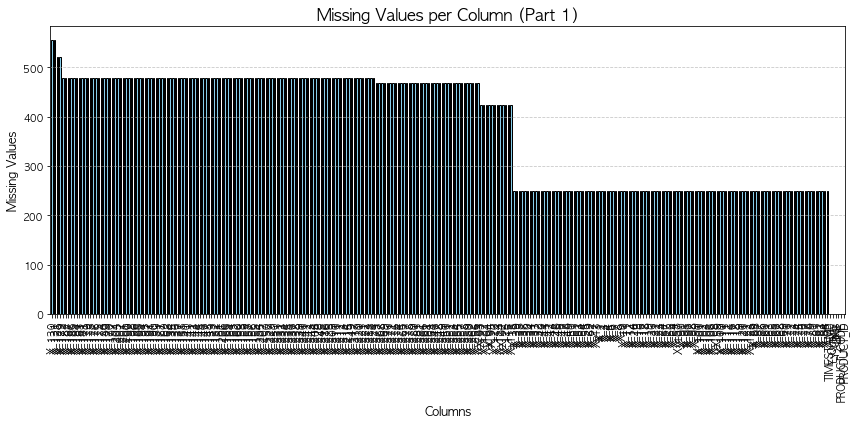

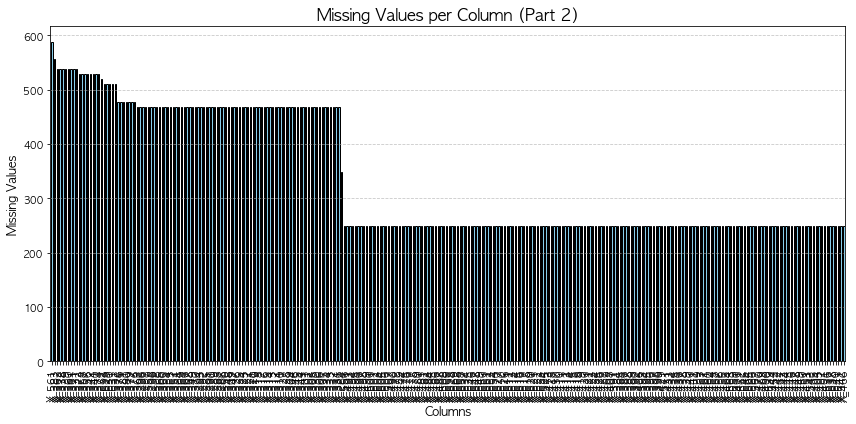

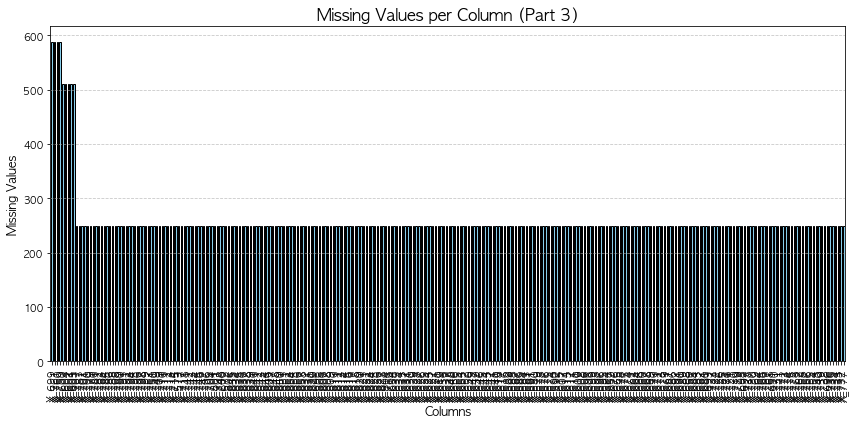

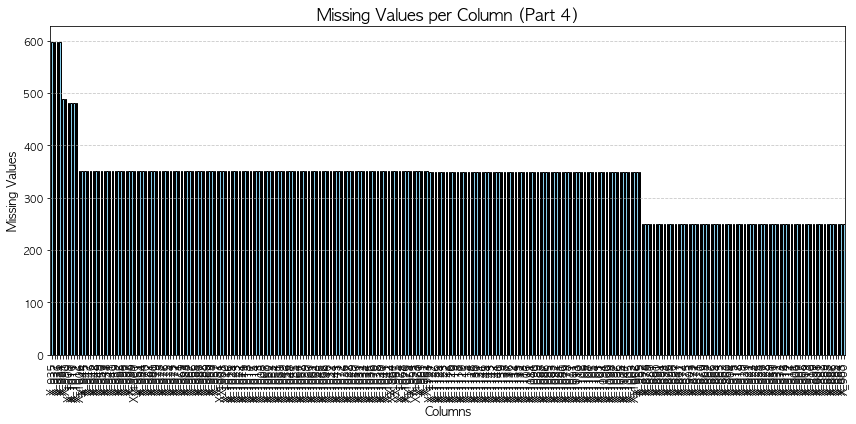

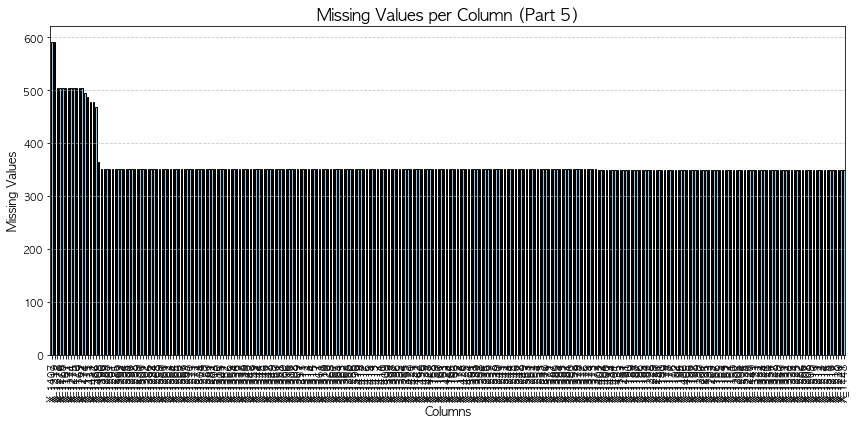

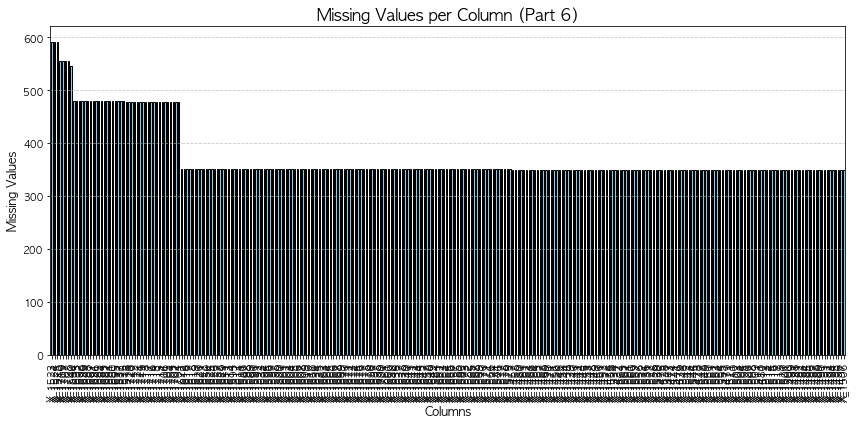

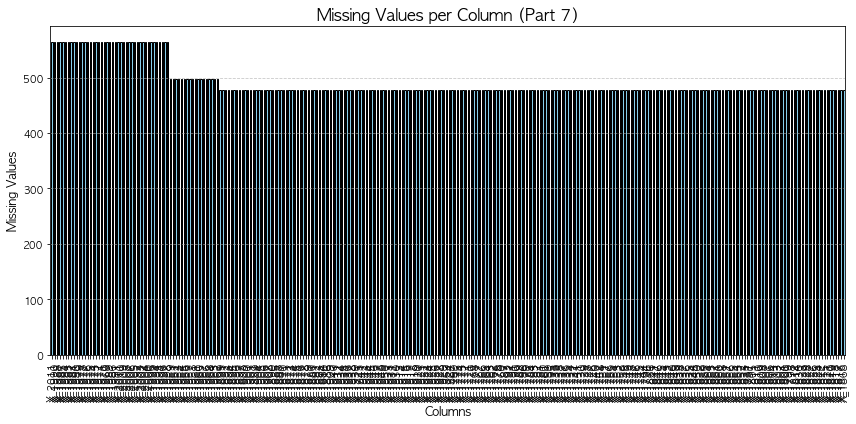

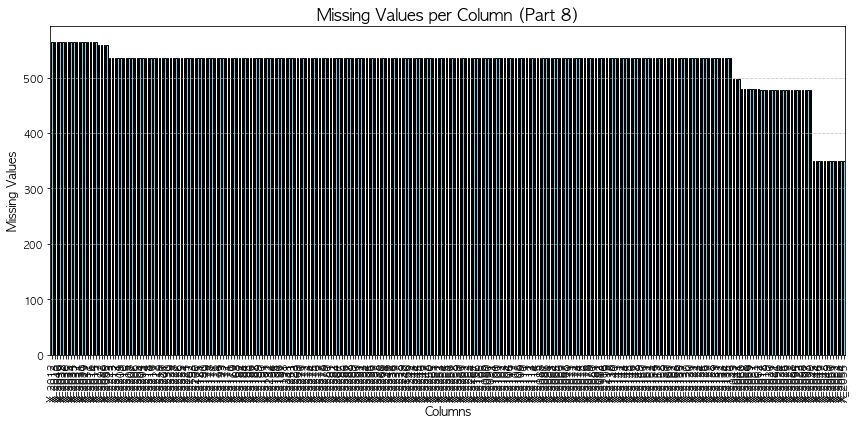

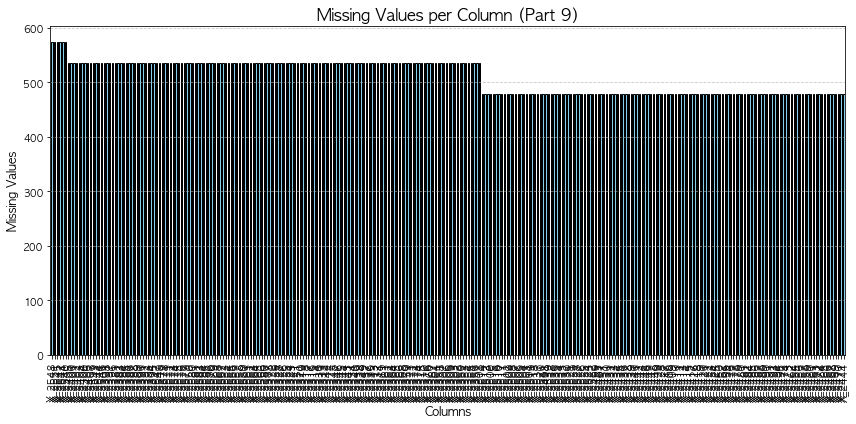

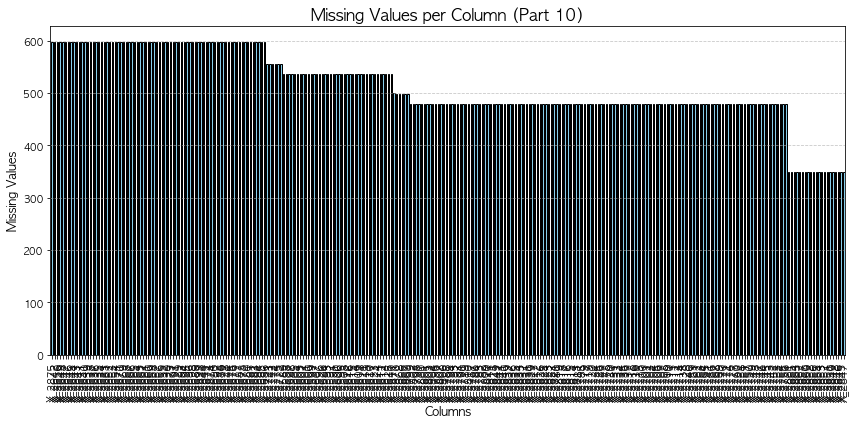

In [10]:
missing_values_per_column = train.isnull().sum()

# 결측치가 있는 컬럼만 필터링
#missing_values_per_column = missing_values_per_column[missing_values_per_column > 0]

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()


### 결측치가 공정 과정에서의 실수나 변수에 의한게 아니라 규칙적으로, 기록되지 않고 있다고 판단할 수 있었다.

 (만약 공정과정에서의 실수나 변수에 의해서 기록되지 않은 결측치라면, 결측치에서 컬럼 별 결측치가 값은 값들이 나오기 어려울 것이라 판단했기 때문이다. 즉, 위와 같은 그래프처럼 일자로 bar plot이 그려지지 않을 것이라 생각한다.)

### 따라서 어떠한 규칙이 있는지 더 파악하기 위해 TIMESTAMP나 PRODUCT_CODE, LINE등의 컬럼을 이용해 데이터를 나눠보고 데이터를 다시 시각화 해 보았다.

1. TIMESTAMP로 데이터 나누기

In [11]:
train['TIMESTAMP'] = pd.to_datetime(train['TIMESTAMP'], format='%Y-%m-%d %H:%M', errors='coerce')

min_timestamp = train['TIMESTAMP'].min()
max_timestamp = train['TIMESTAMP'].max()

print("최소 TIMESTAMP:", min_timestamp)
print("최대 TIMESTAMP:", max_timestamp)

최소 TIMESTAMP: 2022-06-13 05:14:00
최대 TIMESTAMP: 2022-09-08 22:47:00


월별 데이터 나누기

In [12]:
# 새로운 컬럼 'Month' 추가
train['Month'] = train['TIMESTAMP'].dt.month

grouped_data = train.groupby('Month')

june_data = grouped_data.get_group(6) 
july_data = grouped_data.get_group(7) 
august_data = grouped_data.get_group(8) 
september_data = grouped_data.get_group(9)

6월

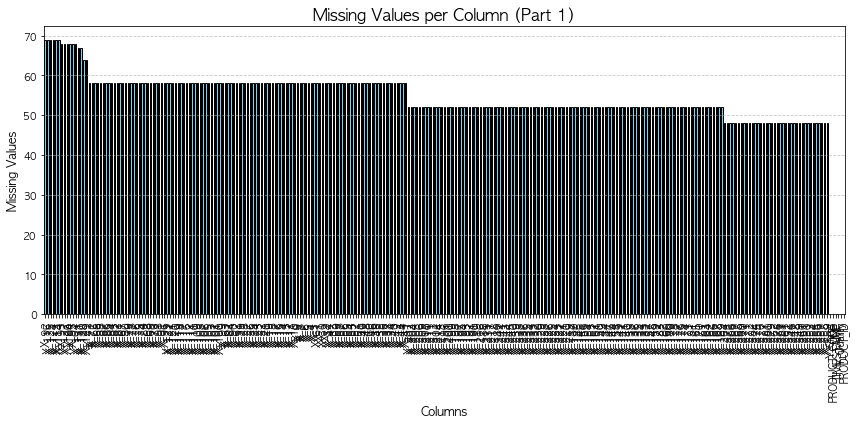

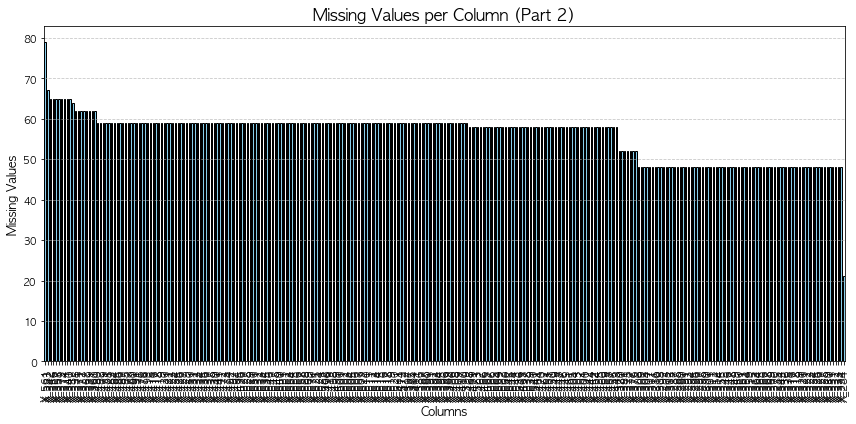

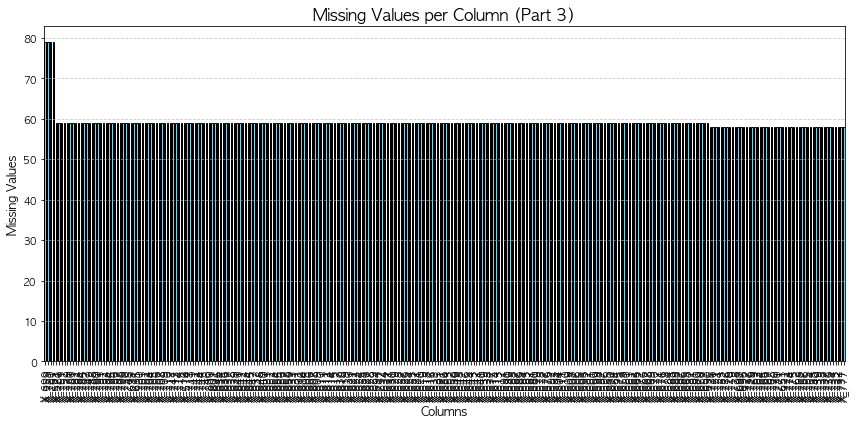

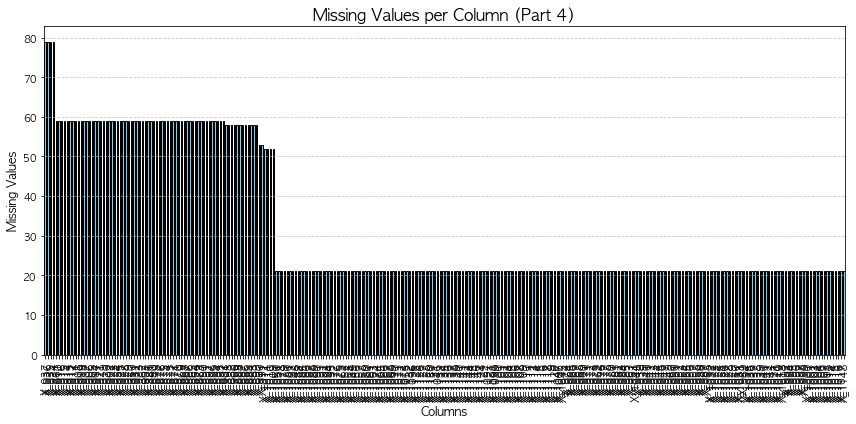

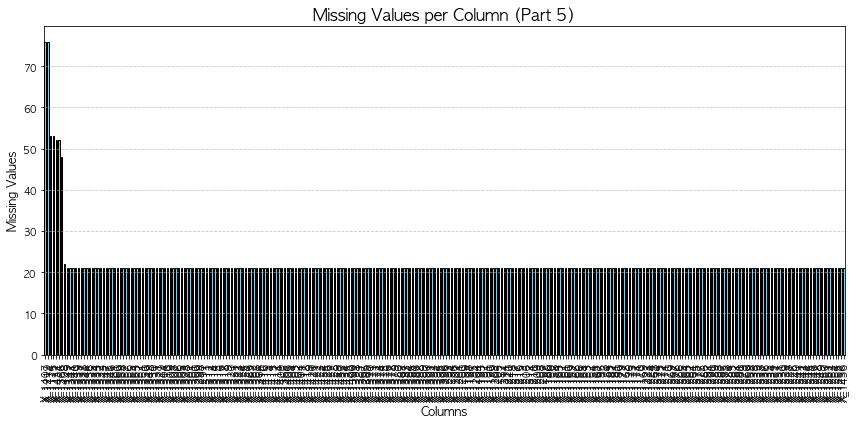

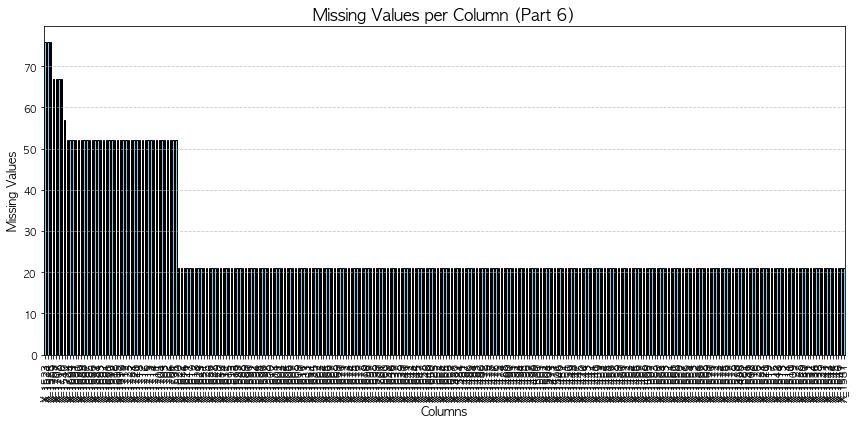

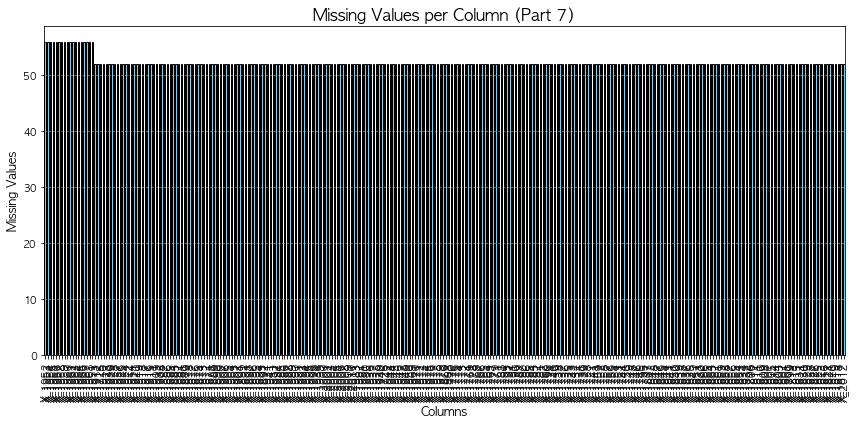

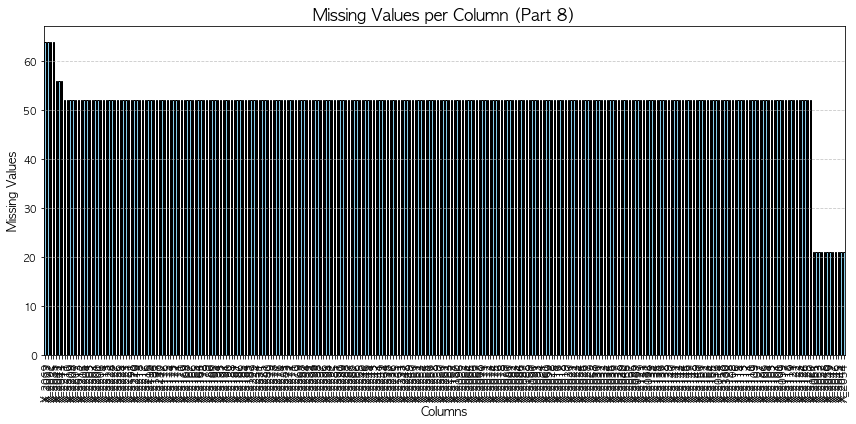

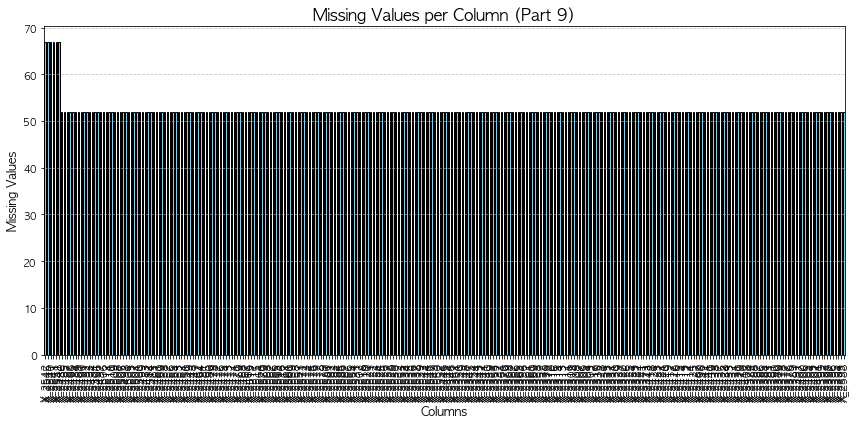

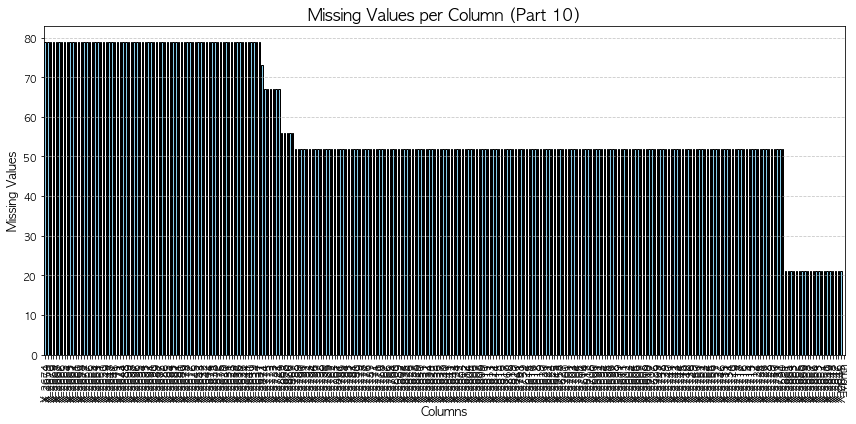

In [13]:
missing_values_per_column = june_data.isnull().sum()

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

7월, 8월, 9월 생략

시간별 데이터 나누기

In [14]:
# 새로운 컬럼 'Hour' 추가
train['Hour'] = train['TIMESTAMP'].dt.hour

grouped_data2 = train.groupby('Hour')

zero_data = grouped_data2.get_group(0) 
six_data = grouped_data2.get_group(6) 
twelve_data = grouped_data2.get_group(12) 
eighteen_data = grouped_data2.get_group(18)

0시

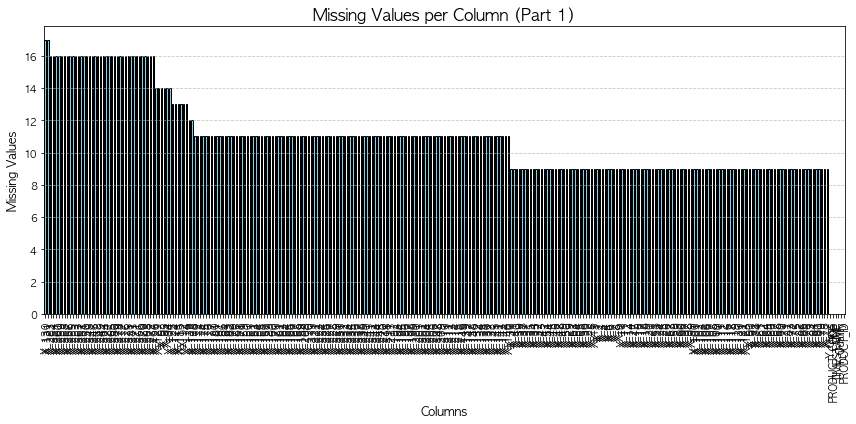

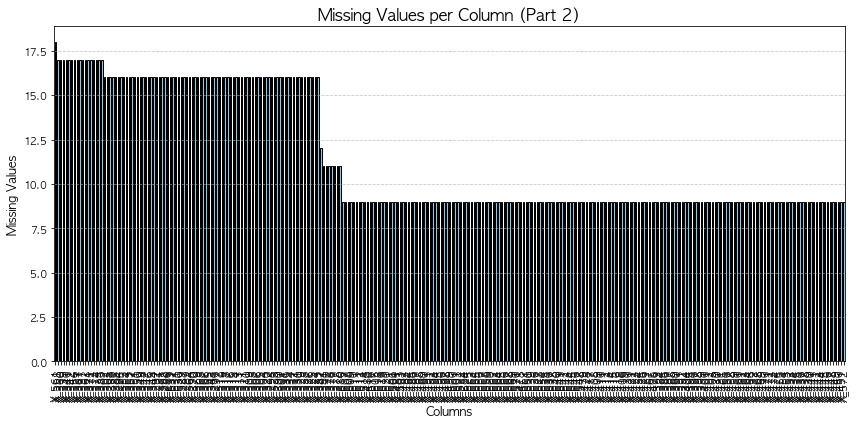

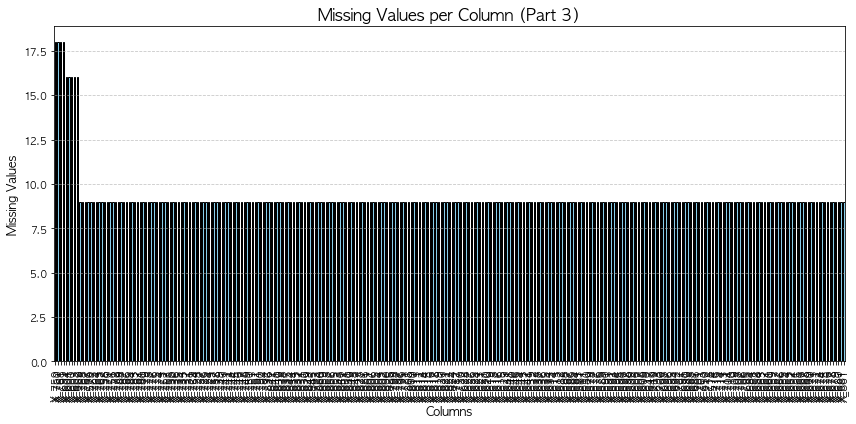

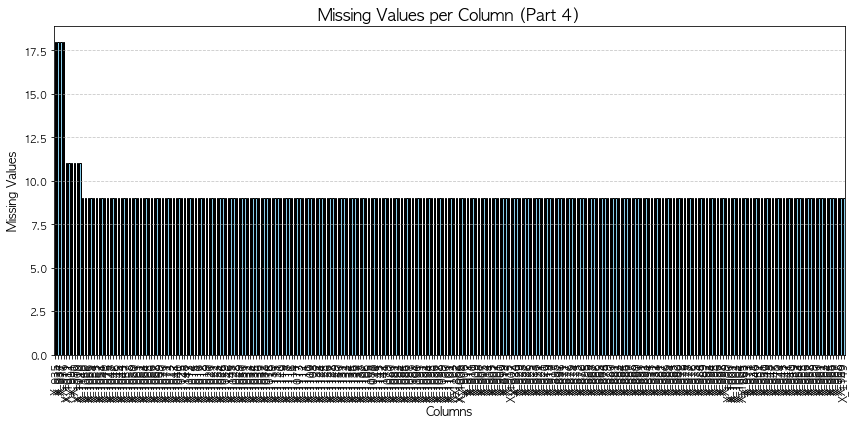

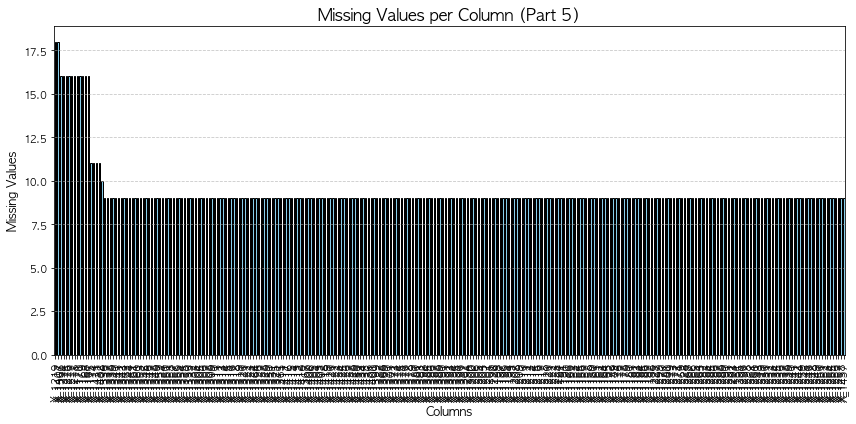

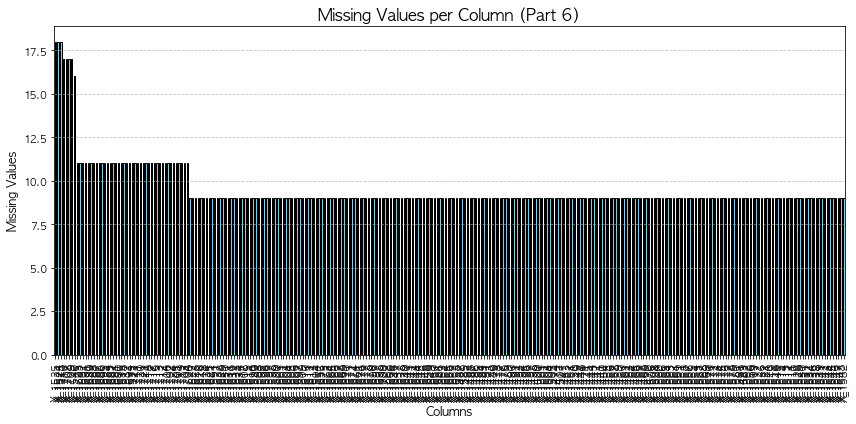

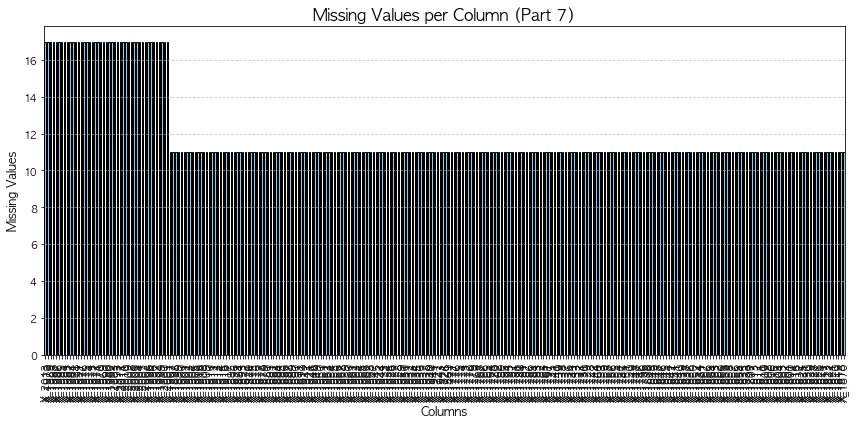

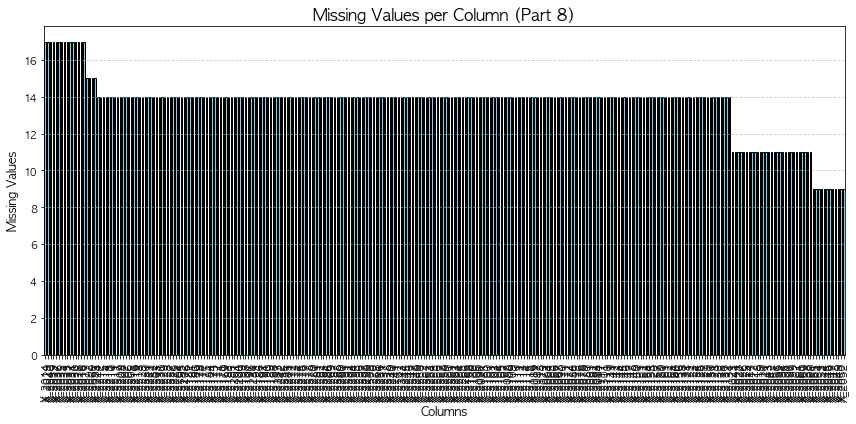

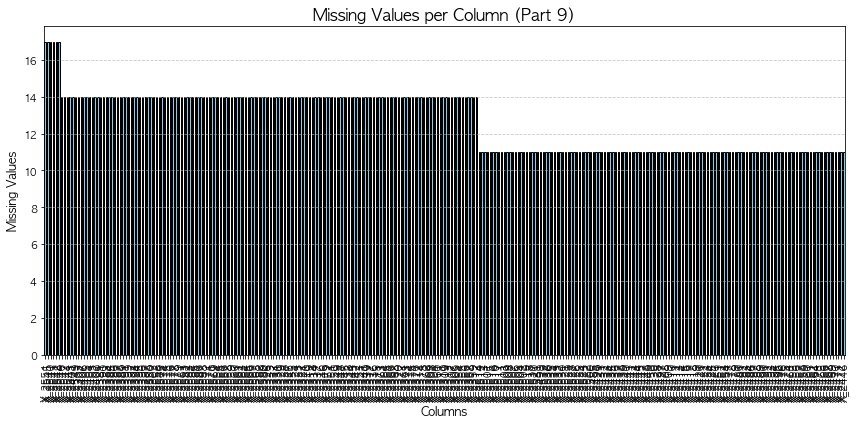

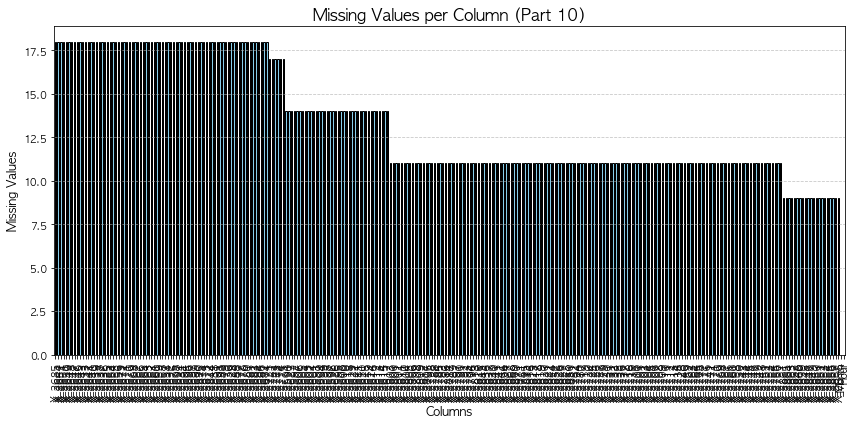

In [15]:
missing_values_per_column = zero_data.isnull().sum()

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

나머지 시간도 생략 (1시~23시)

### 결론 : 월별 혹은 시간별로 나눈 데이터에서는 특별한 특징을 찾지 못함. 

### 2. PRODUCT_CODE로 데이터 나누기

In [16]:
a_data = train[train.PRODUCT_CODE=='A_31']
t_data = train[train.PRODUCT_CODE=='T_31']
o_data = train[train.PRODUCT_CODE=='O_31']

A_31 제품

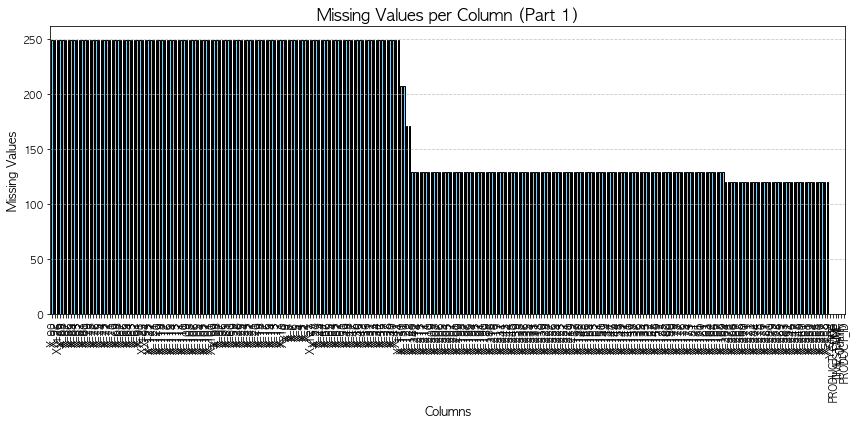

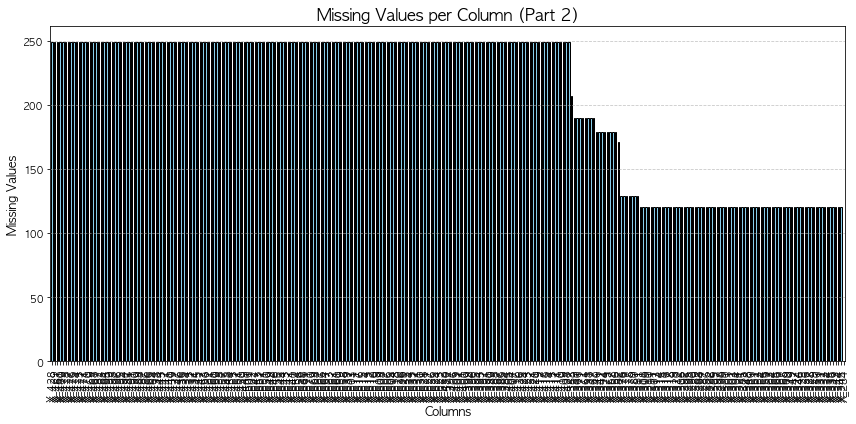

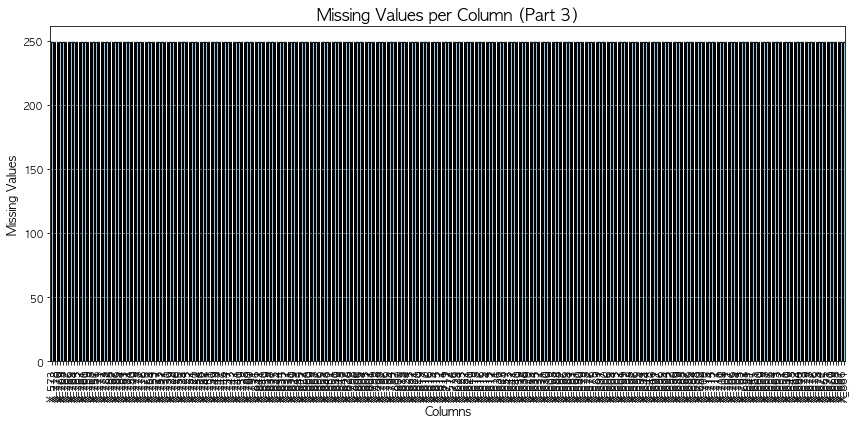

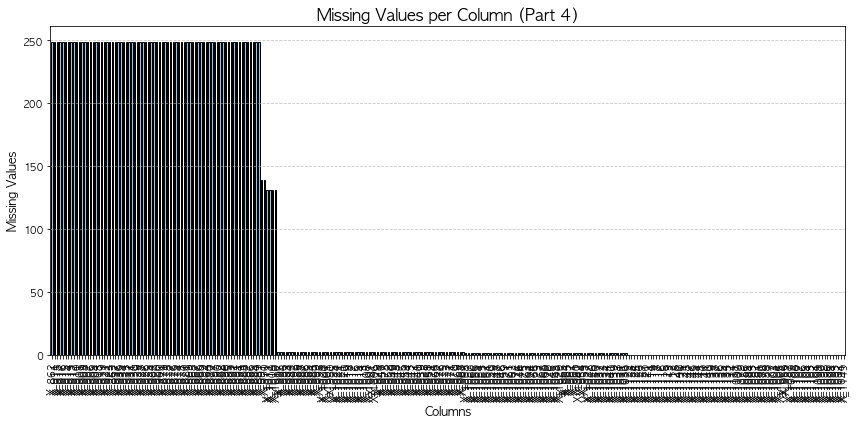

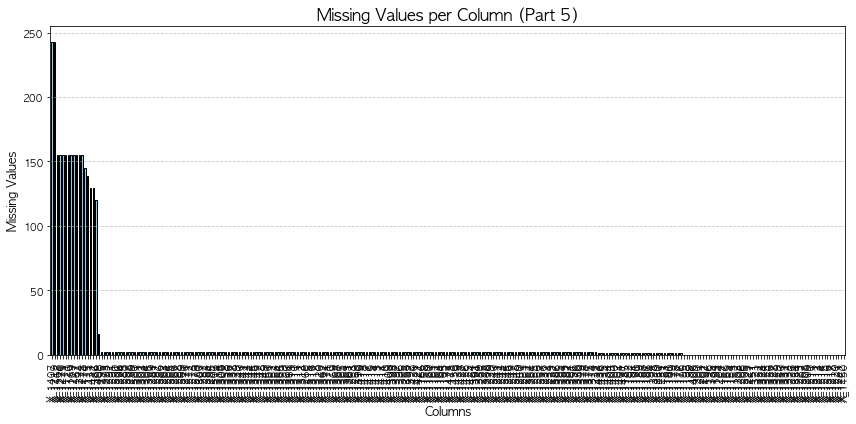

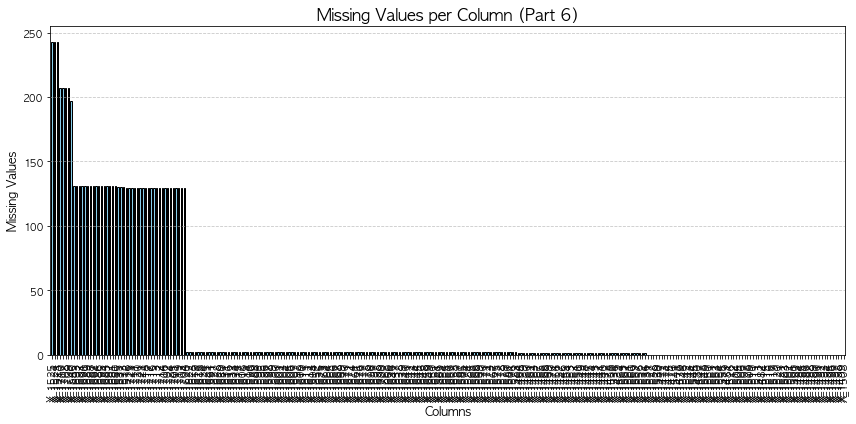

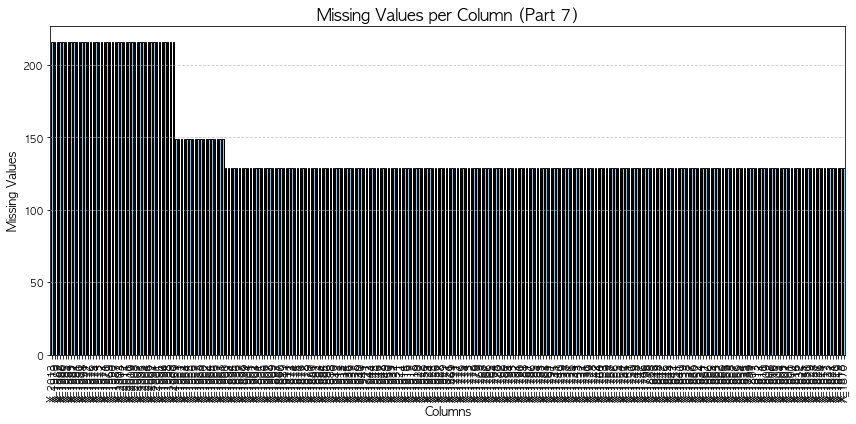

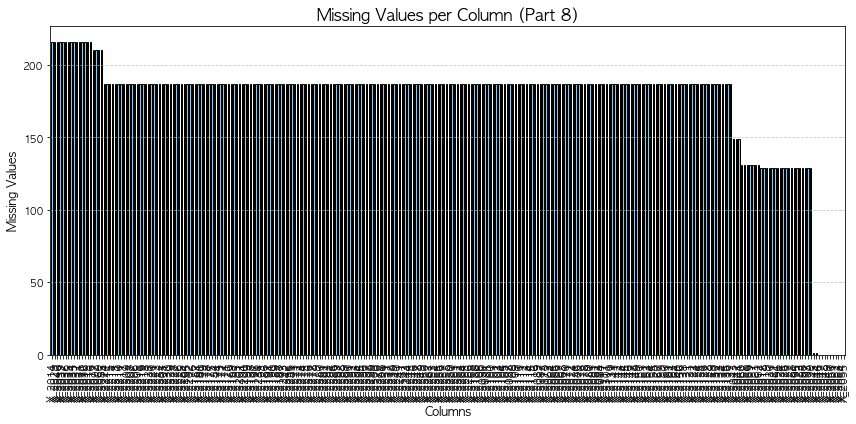

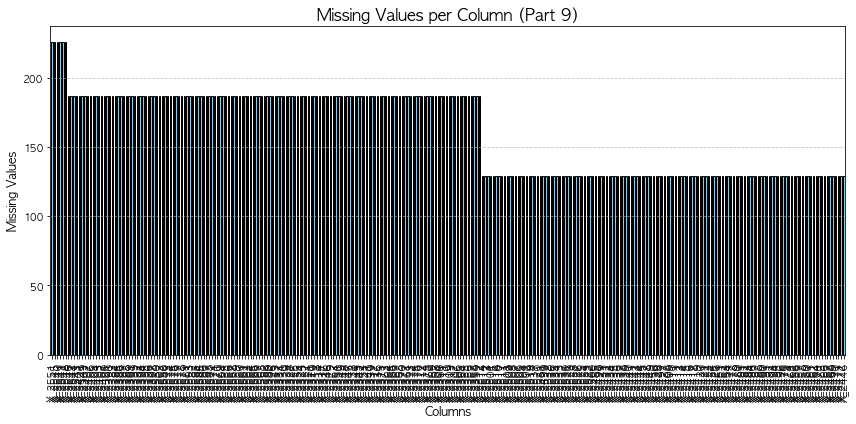

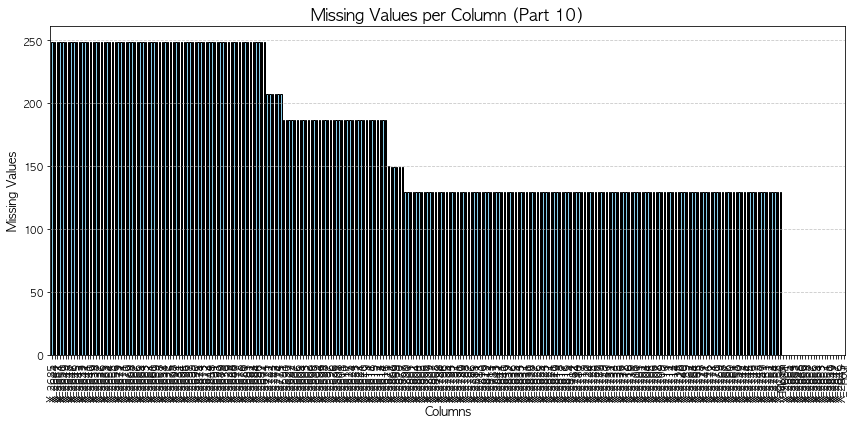

In [17]:
missing_values_per_column = a_data.isnull().sum()

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

### 제품 코드별로 데이터로 나누니 결측치가 하나도 없는 컬럼들이 다수 존재하는 것을 발견했고, 공정 과정에서 제품별로 기록되는 컬럼이 다른 게 아닐까 생각했습니다. 

T_31 제품

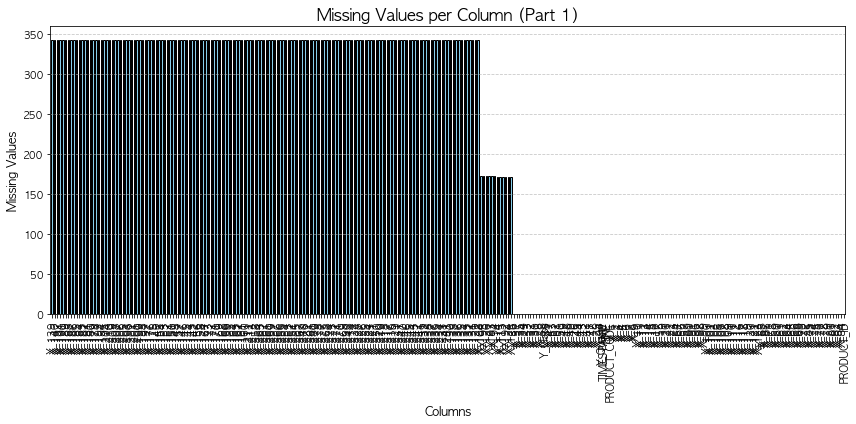

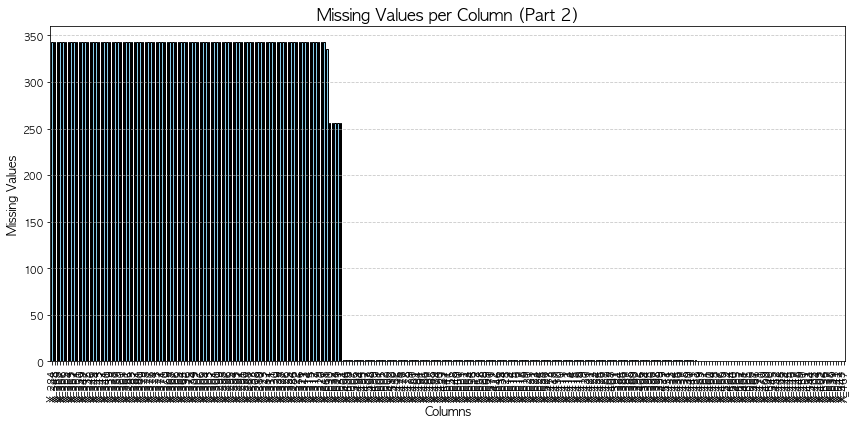

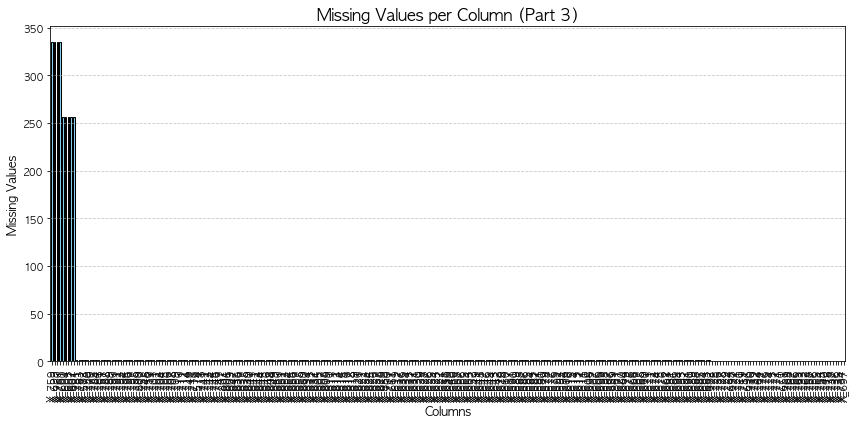

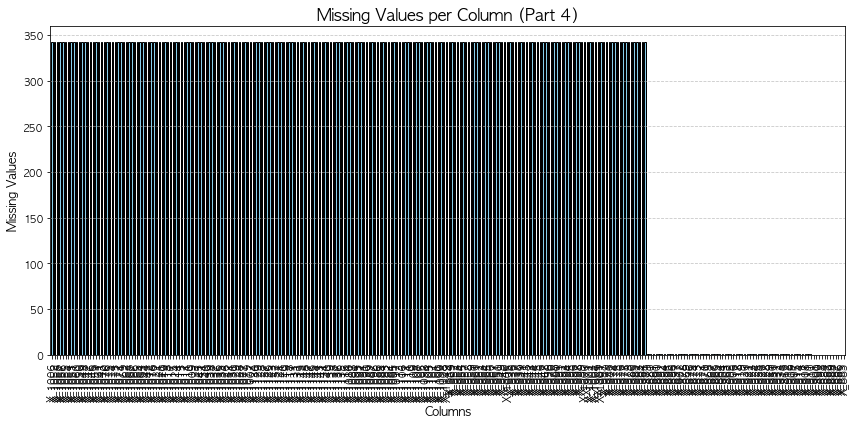

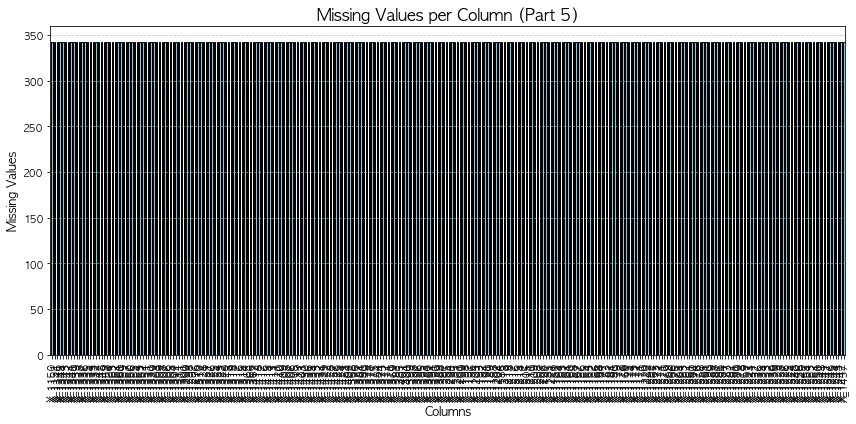

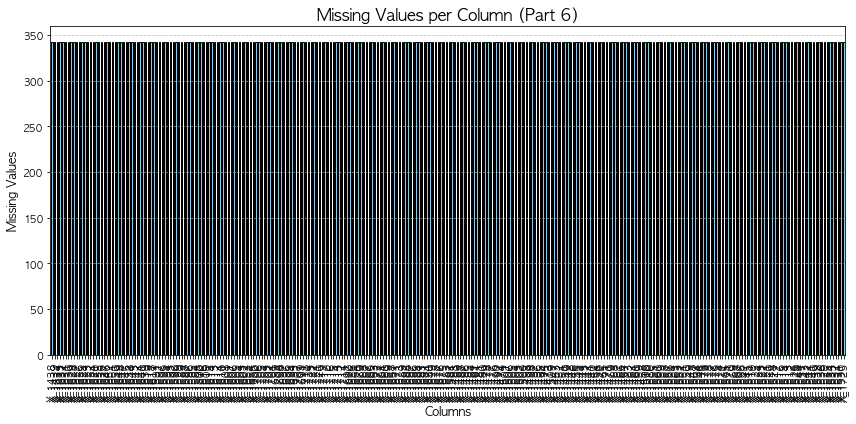

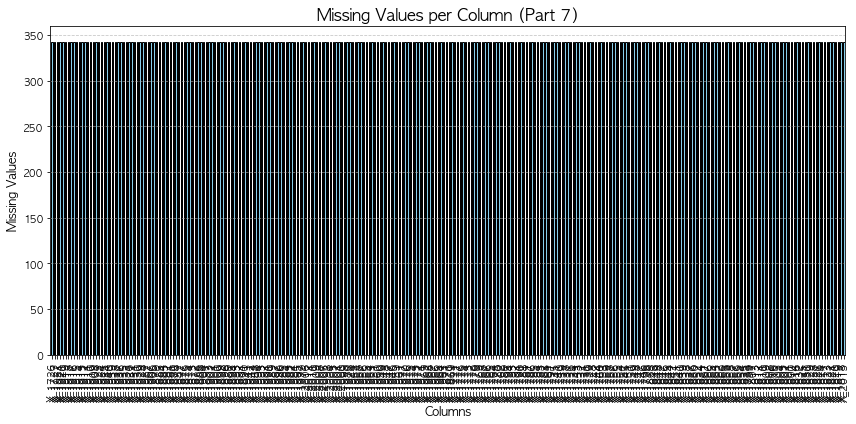

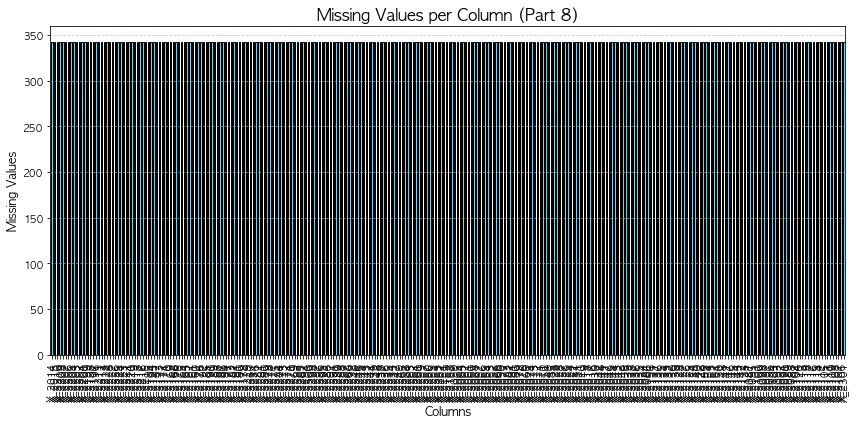

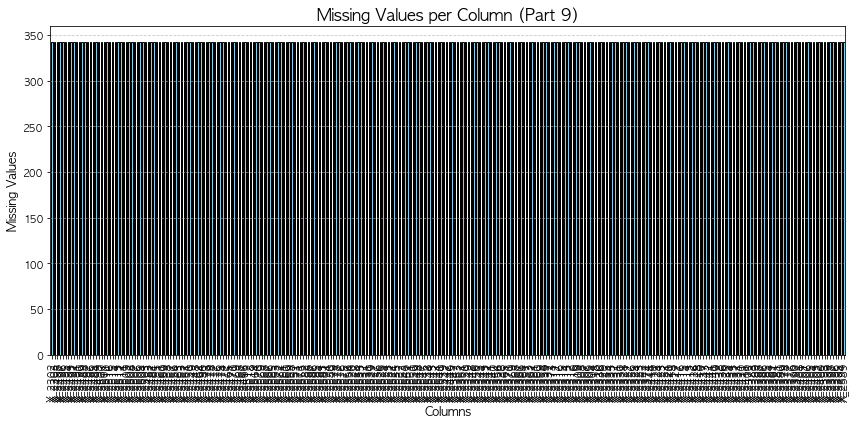

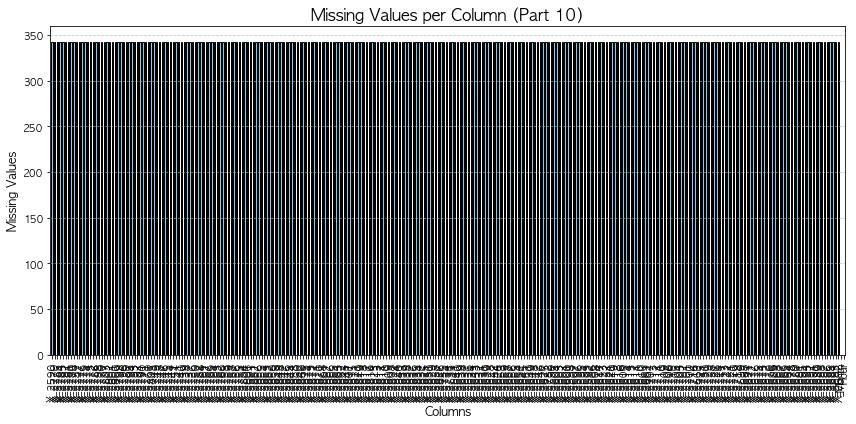

In [18]:
missing_values_per_column = t_data.isnull().sum()

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

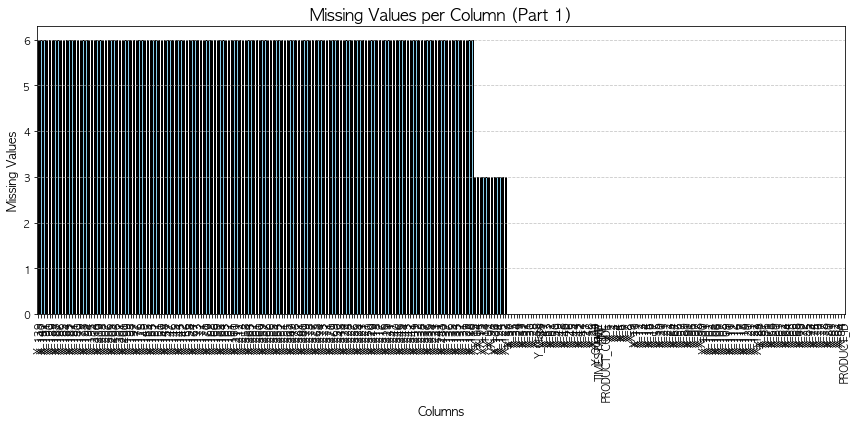

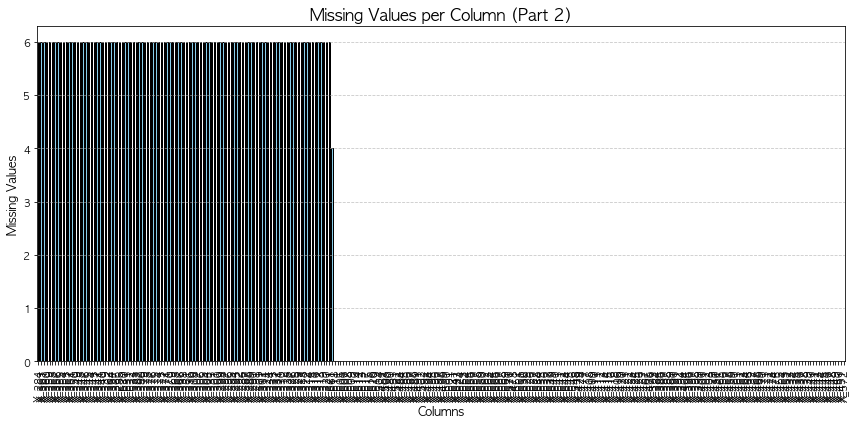

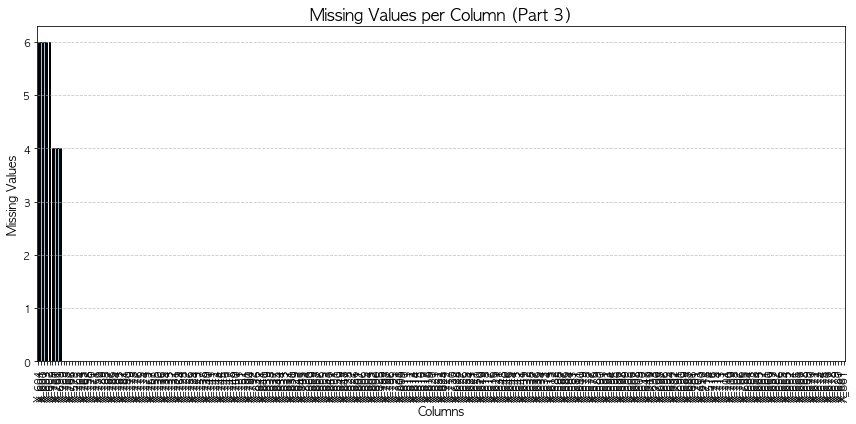

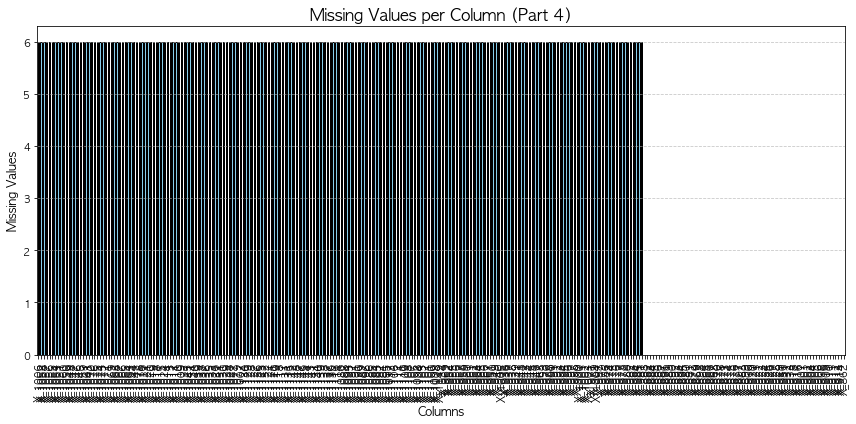

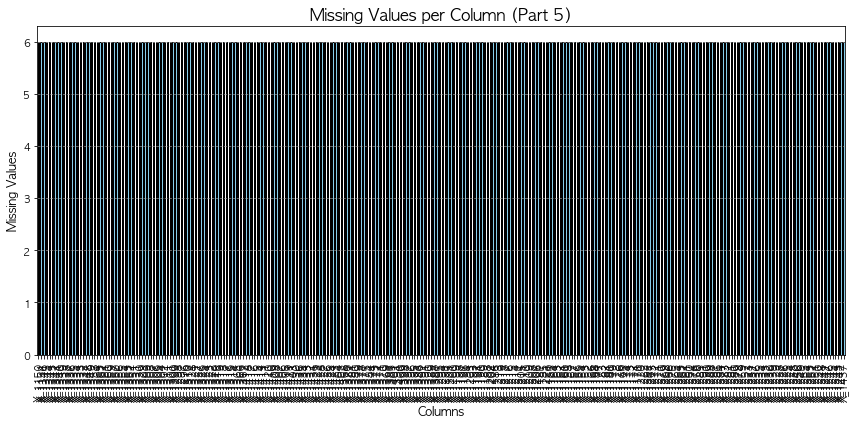

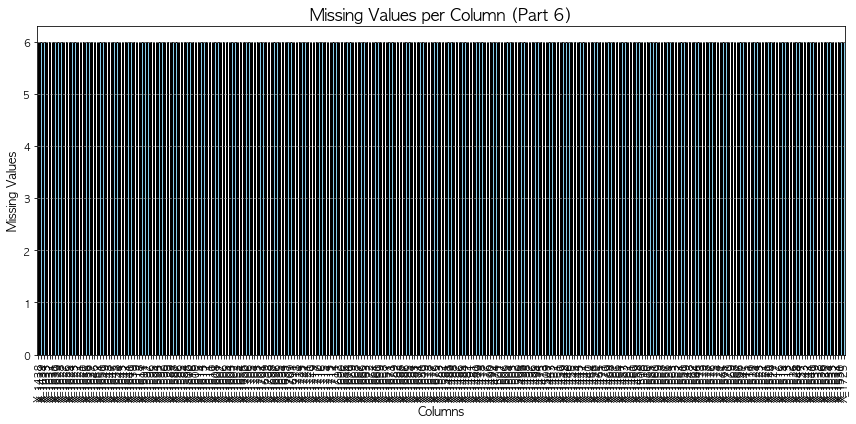

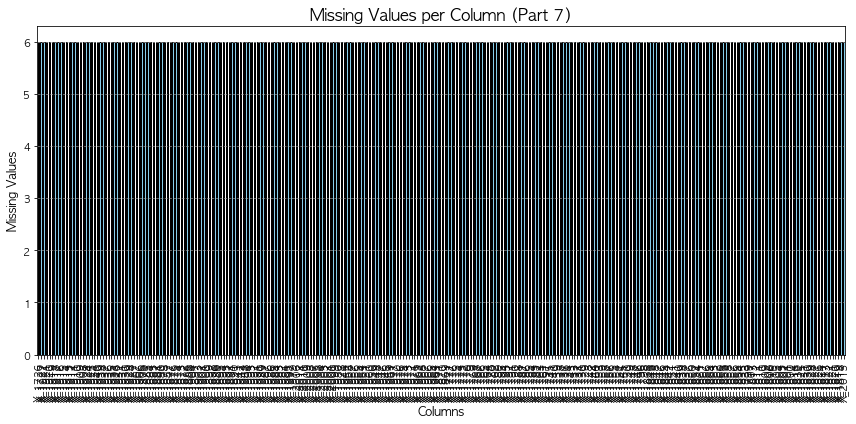

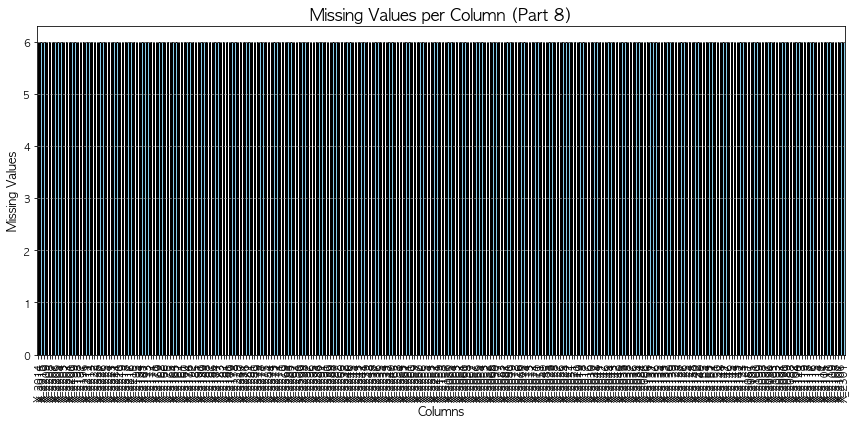

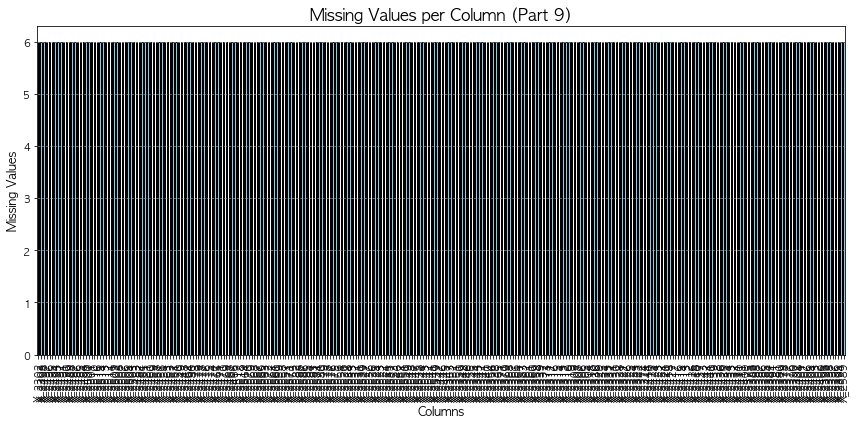

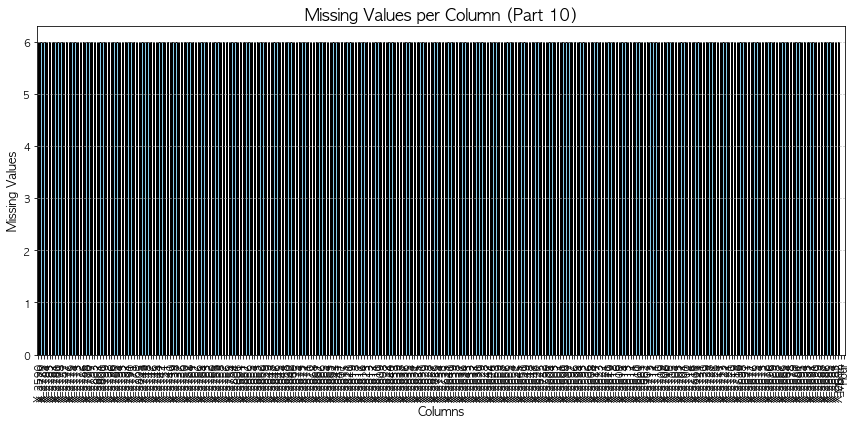

In [19]:
missing_values_per_column = o_data.isnull().sum()

# 컬럼이 너무 많아서 컬럼 10등분 분할
columns_split = np.array_split(missing_values_per_column.index, 10)

for i, column_group in enumerate(columns_split):
    plt.figure(figsize=(12, 6))
    missing_values_per_column[column_group].sort_values(ascending=False).plot(
        kind='bar', color='skyblue', edgecolor='black')
    plt.title(f'Missing Values per Column (Part {i+1})', fontsize=16)
    plt.xlabel('Columns', fontsize=12)
    plt.ylabel('Missing Values', fontsize=12)
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

In [20]:
train.PRODUCT_CODE.value_counts()

T_31    343
A_31    249
O_31      6
Name: PRODUCT_CODE, dtype: int64

### 3. LINE별로 데이터 나누기

In [21]:
train.LINE.unique()

array(['T050304', 'T050307', 'T100304', 'T100306', 'T010306', 'T010305'],
      dtype=object)

In [22]:
a_data.LINE.unique()

array(['T050304', 'T050307', 'T010306', 'T010305'], dtype=object)

In [23]:
t_data.LINE.unique()

array(['T100304', 'T100306'], dtype=object)

In [24]:
o_data.LINE.unique()

array(['T100304', 'T100306'], dtype=object)

### A_31 제품의 경우 4가지의 라인을 이용하지만, T_31 제품과 O_31 제품은 같은 2개의 라인을 이용한다는 것을 발견했습니다.

## 결론 : 기본적으로 데이터 샘플 수에 비해 컬럼이 너무 많기 때문에 과적합 가능성이 높아 컬럼을 제거해야 하는 상황에서, 제품별로 기록되는 컬럼이 상이하고 각 제품마다 중요한 컬럼이 다를 수 있기에, 제품별로 데이터를 나누어 모델을 각각 학습시키기로 결정했습니다. 

### 하지만 O_31 제품의 경우, 샘플이 6개이기 때문에 따로 학습하기엔 과적합 가능성이 높고, T_31 제품과 동일한 라인을 사용하기 때문에 O_31 제품과 T_31 제품은 같이 학습시키는 게 맞다고 판단했습니다.

In [25]:
a_df = train[train.PRODUCT_CODE=='A_31']
to_df = train[(train.PRODUCT_CODE=='T_31')|(train.PRODUCT_CODE=='O_31')]

### A_31 제품과 나머지 두 제품은 아예 다른 제품으로 추론해 볼 수 있고, T_31 제품과 O_31 제품은 기본적으로 같은 제품이지만, 버전이 다른 제품이라고 상상하며 의사결정을 했습니다.

In [26]:
a_df = a_df.drop(columns = ['Month', 'Hour'], axis = 1) #새롭게 만든 컬럼으로 더이상 필요없기에 삭제
to_df = to_df.drop(columns = ['Month', 'Hour'], axis = 1)

## 종속 변수 분포 확인

0은 적정 기준 미달(부적합), 1은 적합, 2는 적정 기준 초과(부적합)

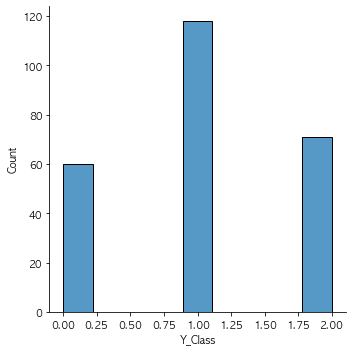

In [27]:
sns.displot(a_df['Y_Class'])

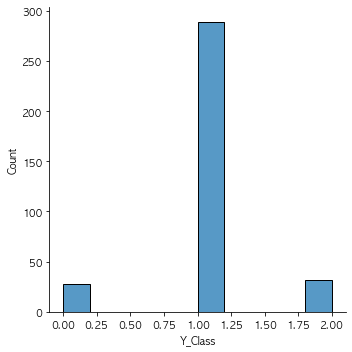

In [28]:
sns.displot(to_df['Y_Class'])

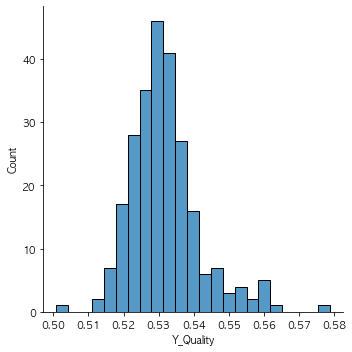

In [29]:
sns.displot(a_df['Y_Quality'])

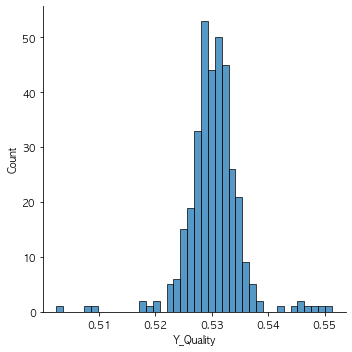

In [30]:
sns.displot(to_df['Y_Quality'])

In [31]:
train['Y_Quality'].min(), train['Y_Quality'].max()

(0.500855556, 0.57884127)

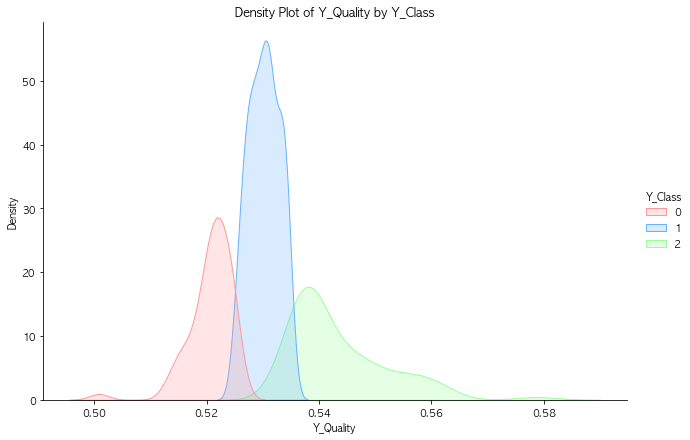

In [32]:
sns.displot(
    data=a_df,
    x='Y_Quality',
    hue='Y_Class',
    kind='kde',
    fill=True,
    palette=['#ff9999', '#66b3ff', '#99ff99'],
    height=6,
    aspect=1.5
)

plt.title('Density Plot of Y_Quality by Y_Class')
plt.xlabel('Y_Quality')
plt.ylabel('Density')
plt.show()

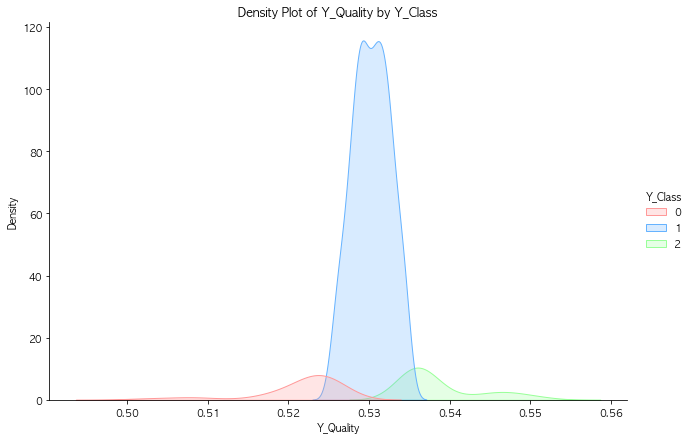

In [33]:
sns.displot(
    data=to_df,
    x='Y_Quality',
    hue='Y_Class',
    kind='kde',
    fill=True,
    palette=['#ff9999', '#66b3ff', '#99ff99'],
    height=6,
    aspect=1.5
)

plt.title('Density Plot of Y_Quality by Y_Class')
plt.xlabel('Y_Quality')
plt.ylabel('Density')
plt.show()

### Y_Quality는 대략 0.500에서 0.578의 범위에 분포하며, Y_Class 값(0, 1, 2)에 따라 색상으로 구분해 본 결과, Y_Class가 0과 1인 데이터뿐만 아니라 1과 2인 데이터도 경계가 명확하지 않고 상당 부분 겹쳐져 있다. 전체적으로 Y_Class 값 간의 분포가 서로 겹쳐 있어 구분이 어려운 경향을 보인다.

### 스마트 팩토리 공정 데이터의 특성상, 여러 컬럼들이 제품의 퀄리티에 수치적으로 영향을 미치지만, 특정 컬럼 한두 개의 값만 부적합해도 해당 제품이 하자로 판정될 수 있다. 이러한 특성이 데이터 분포에서 Y_Class 간 경계가 명확하지 않은 경향으로 나타나는 원인일 수 있다고 생각했다.

## 범주형 데이터 확인

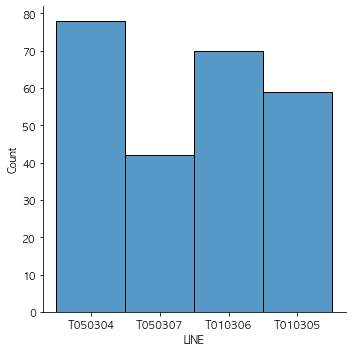

In [34]:
sns.displot(a_df['LINE'])

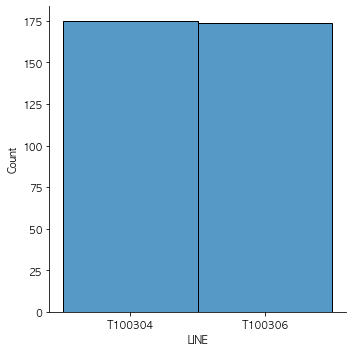

In [35]:
sns.displot(to_df['LINE'])

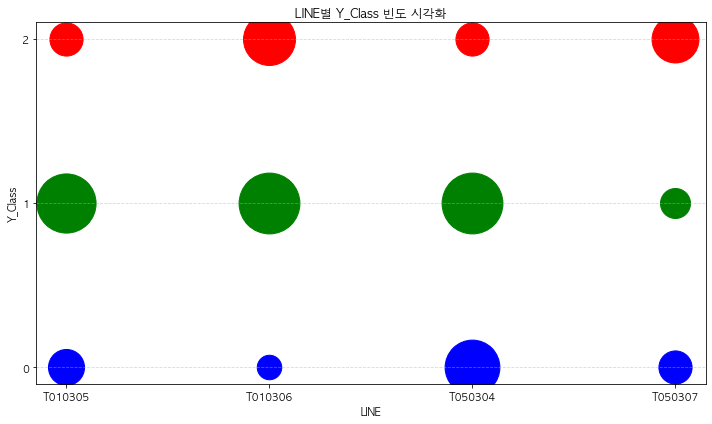

In [36]:
count_df = a_df.groupby(['LINE', 'Y_Class']).size().reset_index(name='count')

plt.figure(figsize=(10, 6))

# LINE 별로 데이터 분리 후 점 찍기
lines = count_df['LINE'].unique()
y_classes = count_df['Y_Class'].unique()
colors = ['blue', 'green', 'red']

for i, line in enumerate(lines):
    subset = count_df[count_df['LINE'] == line]
    for j, y_class in enumerate(y_classes):
        value = subset[subset['Y_Class'] == y_class]['count']
        if not value.empty:
            plt.scatter(
                [i], [y_class],  # LINE 값 별 X 위치와 Y_Class 값
                s=value * 100,  # 점의 크기를 빈도수에 비례
                color=colors[j],
                label=f'Y_Class {y_class}' if i == 0 else ""
            )

plt.xticks(range(len(lines)), lines)
plt.yticks(y_classes)
plt.xlabel('LINE')
plt.ylabel('Y_Class')
plt.title('LINE별 Y_Class 빈도 시각화')
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

### LINE별 Y_Class 빈도를 시각화해 각 라인에 특별한 문제는 없는지 찾아보았다.

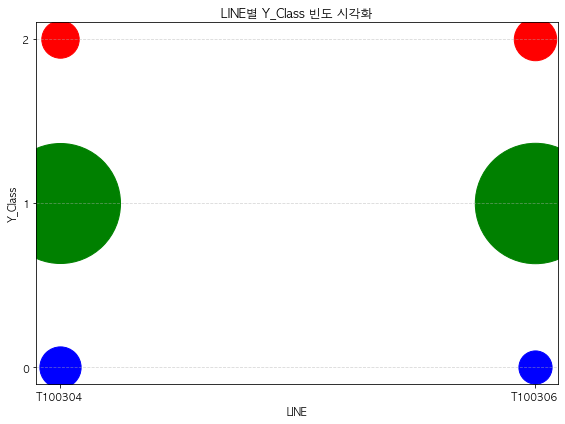

In [37]:
count_df = to_df.groupby(['LINE', 'Y_Class']).size().reset_index(name='count')

plt.figure(figsize=(8, 6))

# LINE 별로 데이터 분리 후 점 찍기
lines = count_df['LINE'].unique()
y_classes = count_df['Y_Class'].unique()
colors = ['blue', 'green', 'red']

for i, line in enumerate(lines):
    subset = count_df[count_df['LINE'] == line]
    for j, y_class in enumerate(y_classes):
        value = subset[subset['Y_Class'] == y_class]['count']
        if not value.empty:
            plt.scatter(
                [i], [y_class],  # LINE 값 별 X 위치와 Y_Class 값
                s=value * 100,  # 점의 크기를 빈도수에 비례
                color=colors[j],
                label=f'Y_Class {y_class}' if i == 0 else ""
            )

plt.xticks(range(len(lines)), lines)
plt.yticks(y_classes)
plt.xlabel('LINE')
plt.ylabel('Y_Class')
plt.title('LINE별 Y_Class 빈도 시각화')
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

### A_31 데이터 시각화 그래프에서 T050307 line의 경우, Y_Class가 1인 빈도가 눈에 띄게 적은 것으로 보아 문제가 있을 수 있다고 생각했다. -> LINE 데이터 중요

## 전체 데이터 분포 확인

### 전체 데이터 분포를 확인하며서 각 컬럼과 종속 변수와의 관계도 같이 보기 위해 0, 1, 2 값에 따라 다른 색깔로 histogram을 그려보았다.

A_31 제품

In [38]:
a_df_ = a_df.drop(columns = ['PRODUCT_ID', 'TIMESTAMP', 'PRODUCT_CODE', 'Y_Quality'], axis = 1)
a_df_nullx = a_df_.dropna(axis = 1, how = 'all')

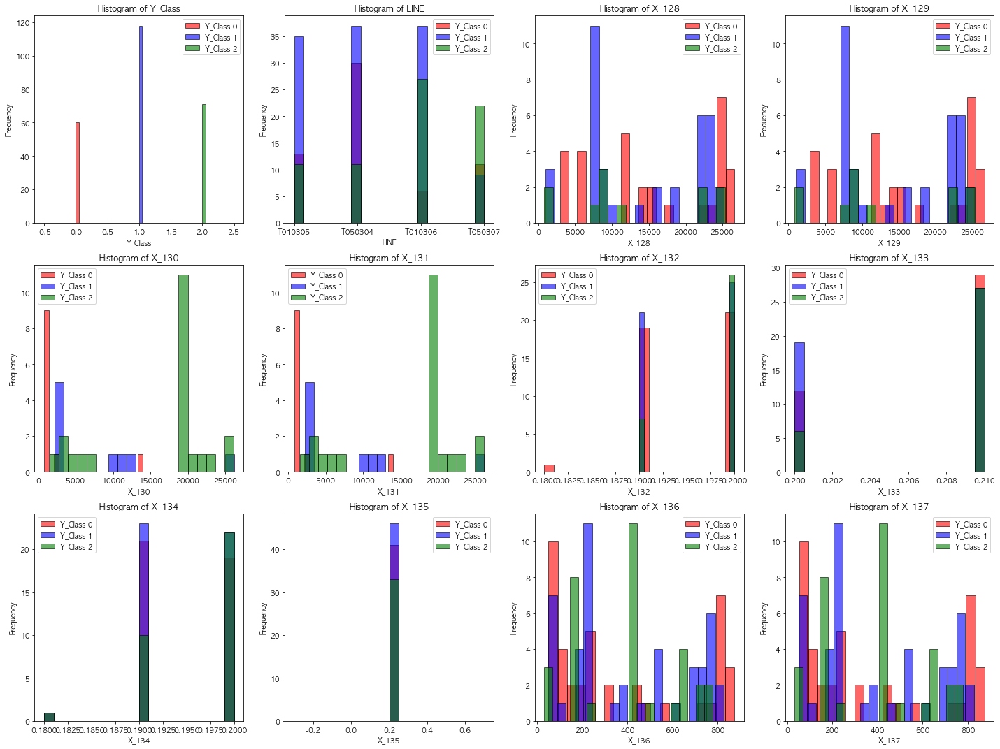

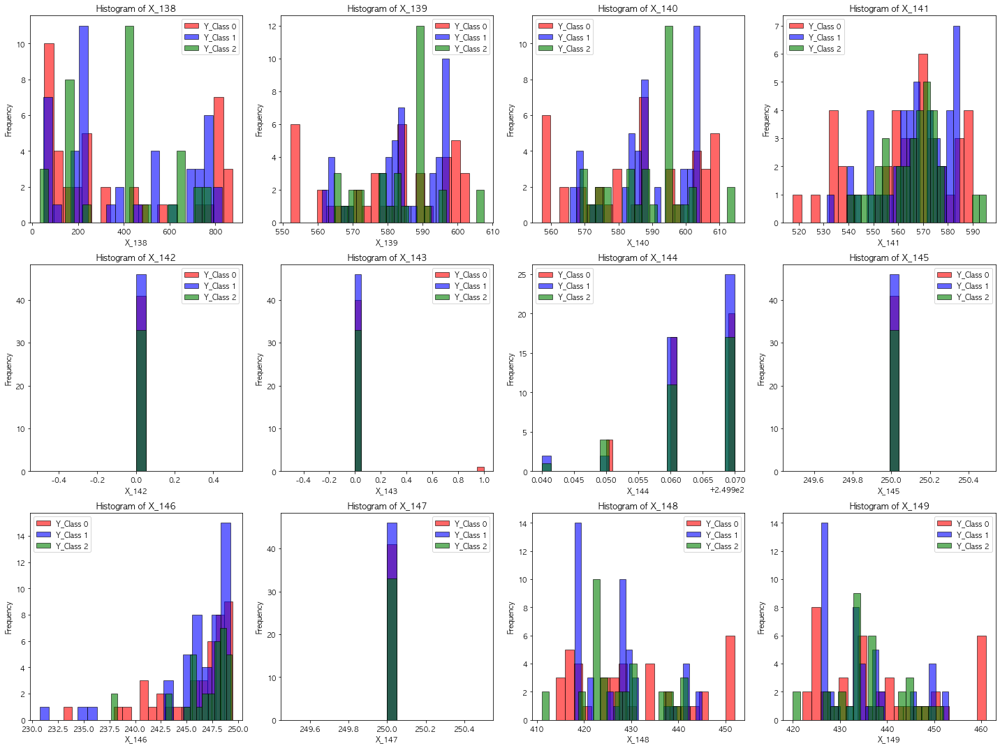

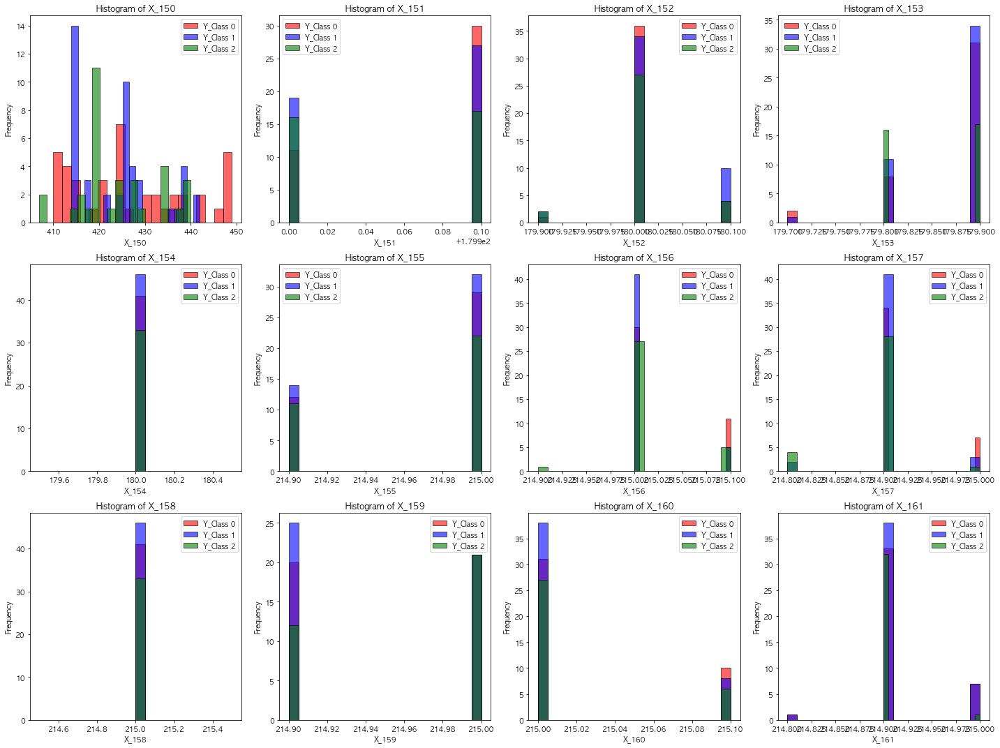

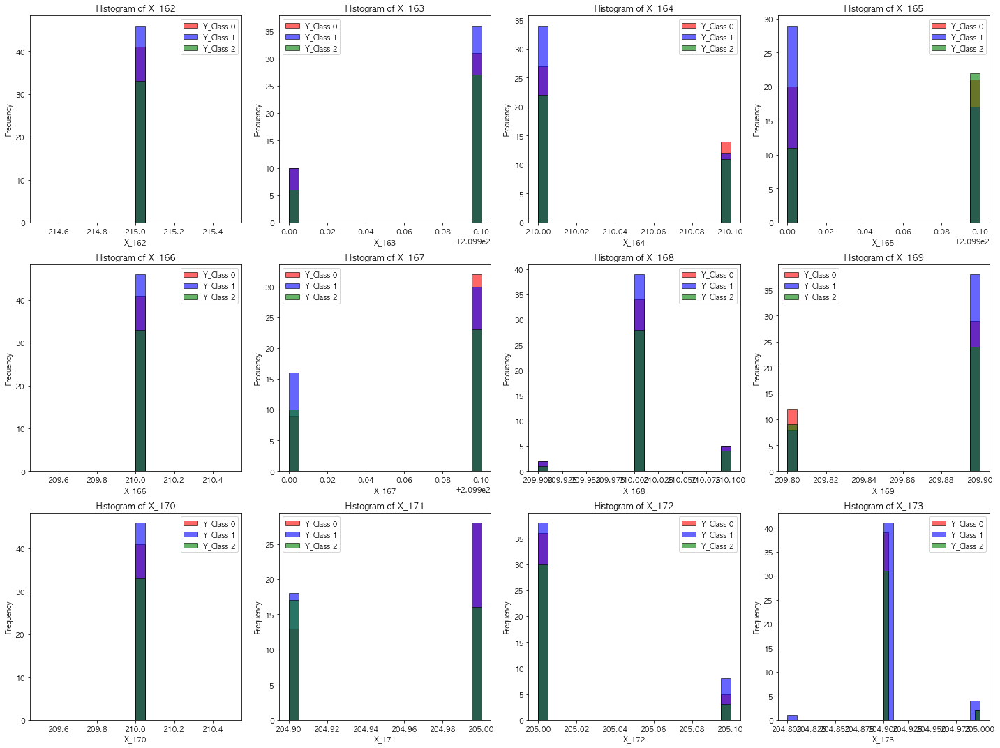

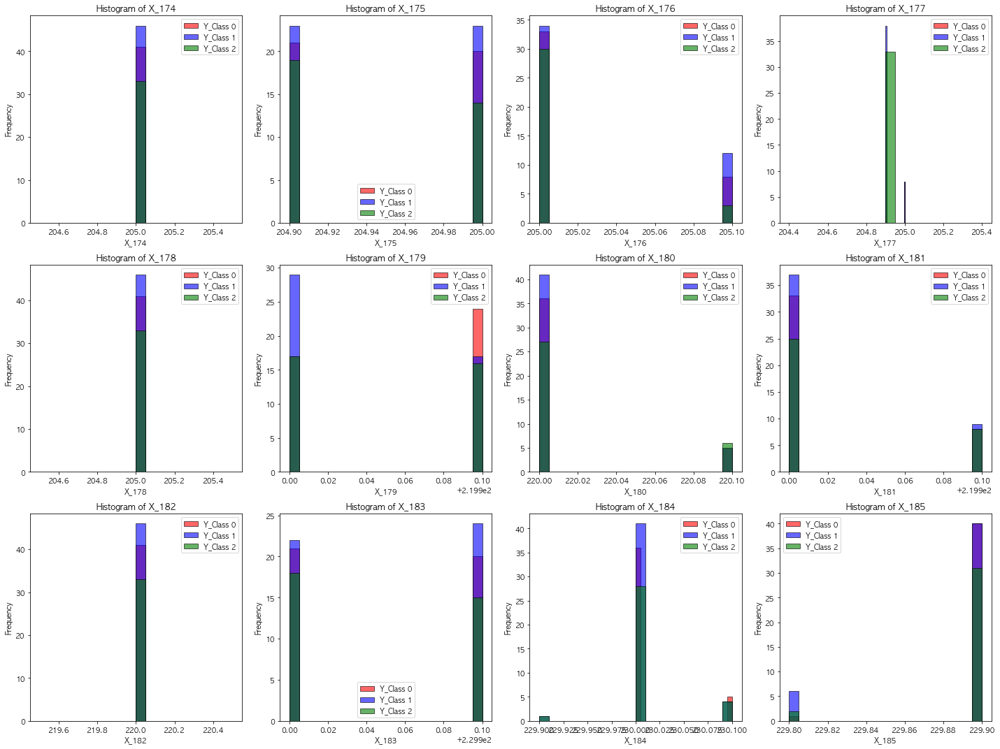

...

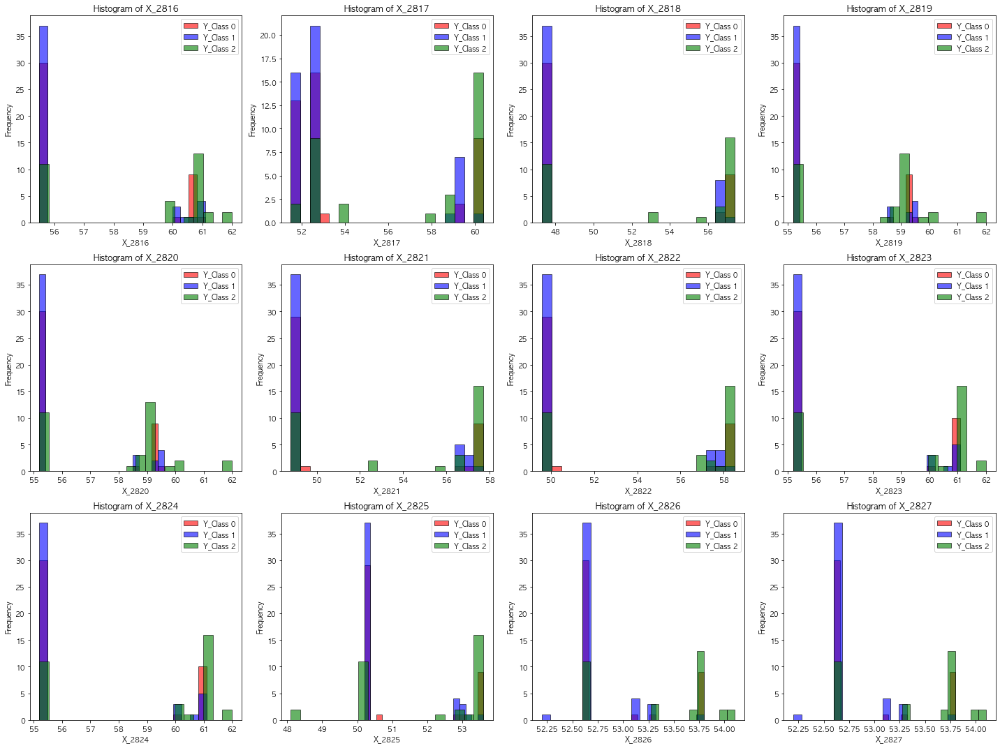

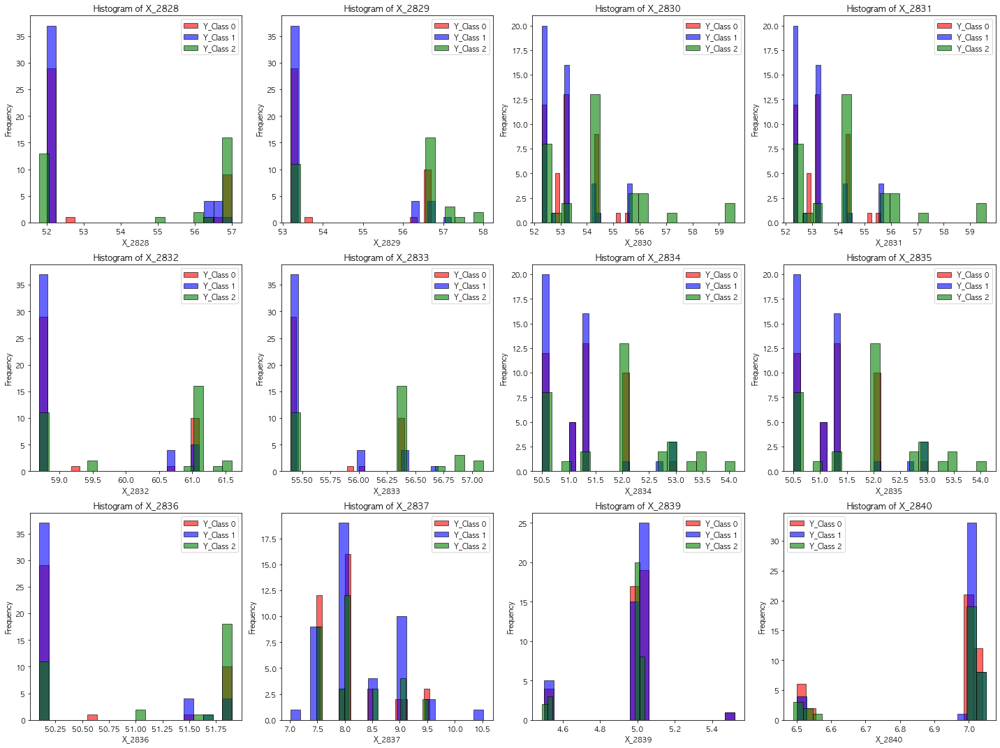

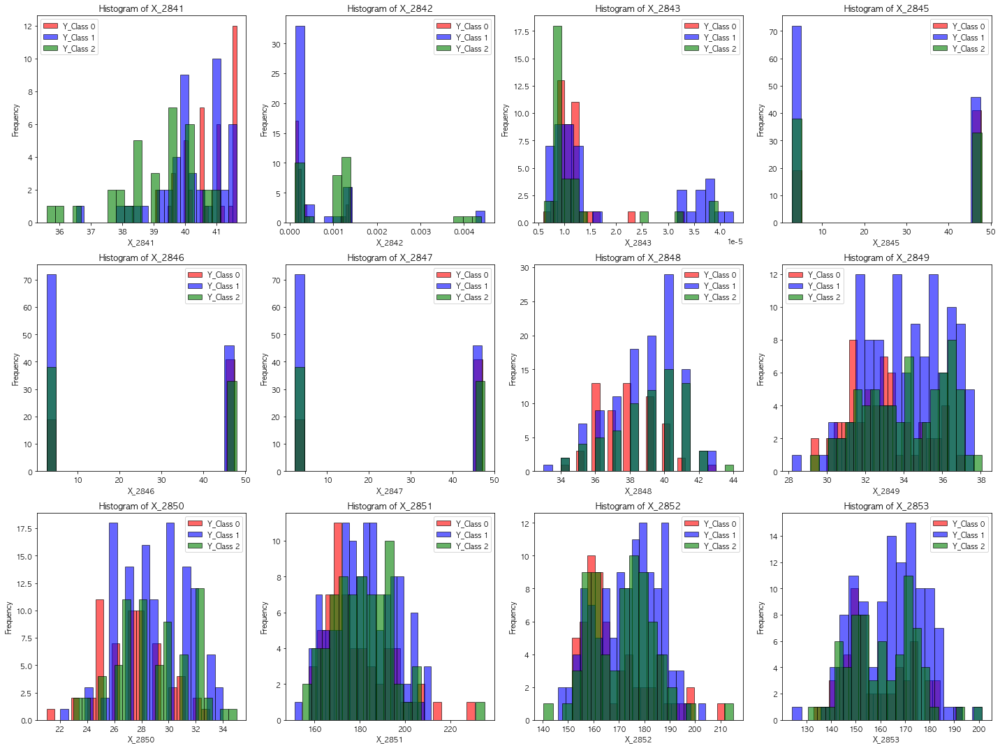

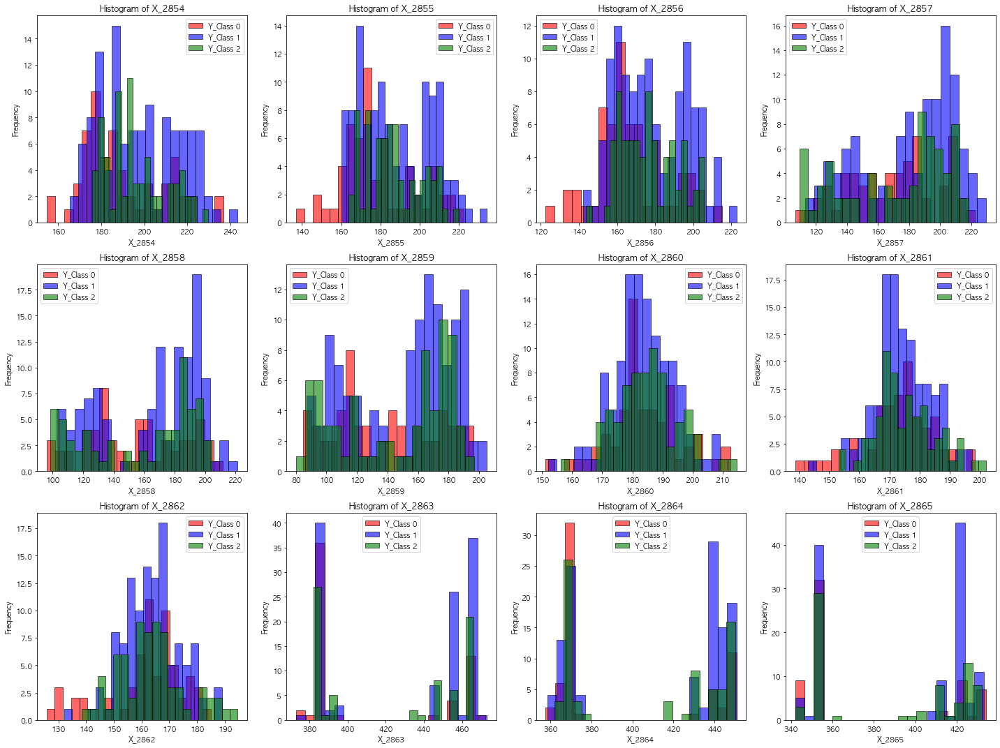

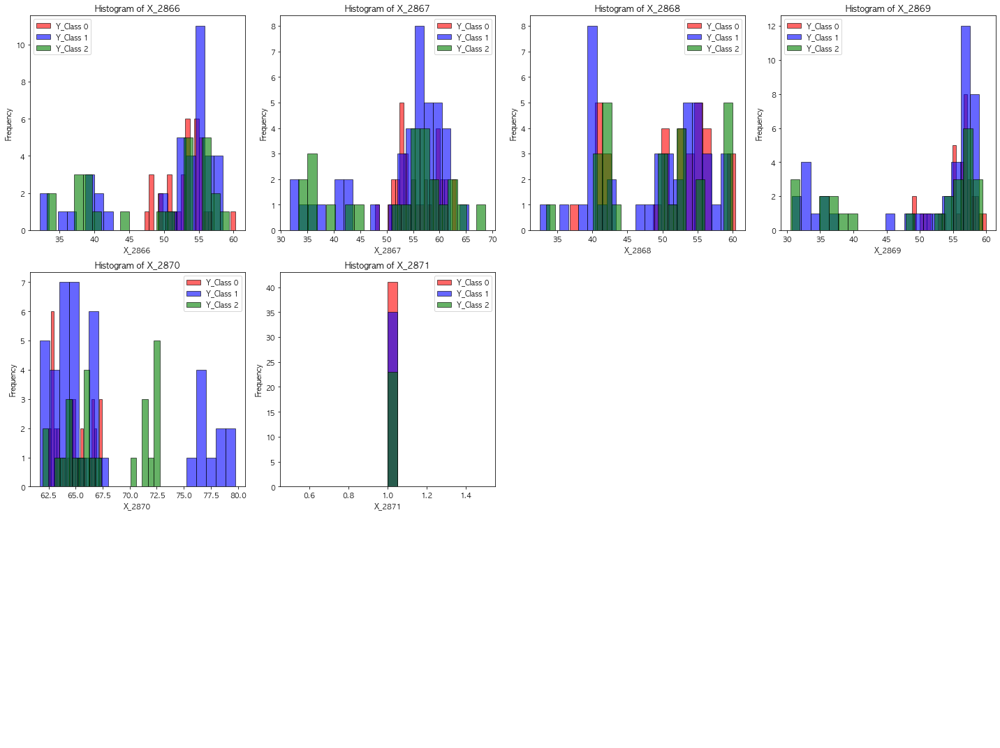

In [39]:
# 12개씩 그리기
columns_per_page = 12
total_columns = len(a_df_nullx.columns)
total_pages = math.ceil(total_columns / columns_per_page)

colors = {0: 'red', 1: 'blue', 2: 'green'}

for page in range(total_pages):
    start_idx = page * columns_per_page
    end_idx = start_idx + columns_per_page
    columns_to_plot = a_df_nullx.columns[start_idx:end_idx]
    
    # 서브플롯
    fig, axs = plt.subplots(3, 4, figsize=(20, 15))
    axs = axs.flatten()
    
    for ax, column in zip(axs, columns_to_plot):
        # Y_Class 별로 히스토그램 생성
        for y_class, color in colors.items():
            subset = a_df_nullx[a_df_nullx['Y_Class'] == y_class]
            ax.hist(subset[column].dropna(), bins=20, color=color, edgecolor='black', alpha=0.6, label=f'Y_Class {y_class}')
        
        ax.set_title(f'Histogram of {column}')
        ax.set_xlabel(column)
        ax.set_ylabel('Frequency')
        ax.legend()
    
    for ax in axs[len(columns_to_plot):]:
        ax.axis('off')
        
    plt.tight_layout()
    plt.show()

- 한 번 더 라인 T050307에서 유독 적합의 비율이 낮은 것을 볼 수 있다.
- 라인 T050304에서 유독 적정 기준보다 미달인 부적합의 비율이 높다.
- X_128이나 X_129의 경우 값의 분포가 비슷하고, 부적합이나 적합의 경계가 전혀 없다.
- X_130이나 X_131의 경우도 값의 분포가 비슷하고, 부적합이나 적합의 경계가 전혀 없다. 이렇게 거의 같은 분포의 컬럼이 2개씩 있다는 것은 한 컬럼이 다른 한 컬럼에 큰 영향을 미치는 상황이라 예상해보았다. (이러한 컬럼 쌍이 많다면 상관관계가 높은 컬럼들이 많을 것이다.)
- 위와 같이 부적합과 적합의 경계가 없는 이런 값의 분포가 나타나는 이유는 해당 컬럼들로 인해 적합/부적합 판정이 나는 것이 아니기 때문이라고 생각했다. (위의 값들이 모두 적정값들일 수 있다.)

### 위와 같은 비슷한 분포의 컬럼들은 상관관계 분석을 통해 제거하거나 PCA 과정에서 축소될 것이다.

T_31/O_31 제품

In [40]:
to_df_ = to_df.drop(columns = ['PRODUCT_ID', 'TIMESTAMP', 'PRODUCT_CODE', 'Y_Quality'], axis = 1)
to_df_nullx = to_df_.dropna(axis = 1, how = 'all')

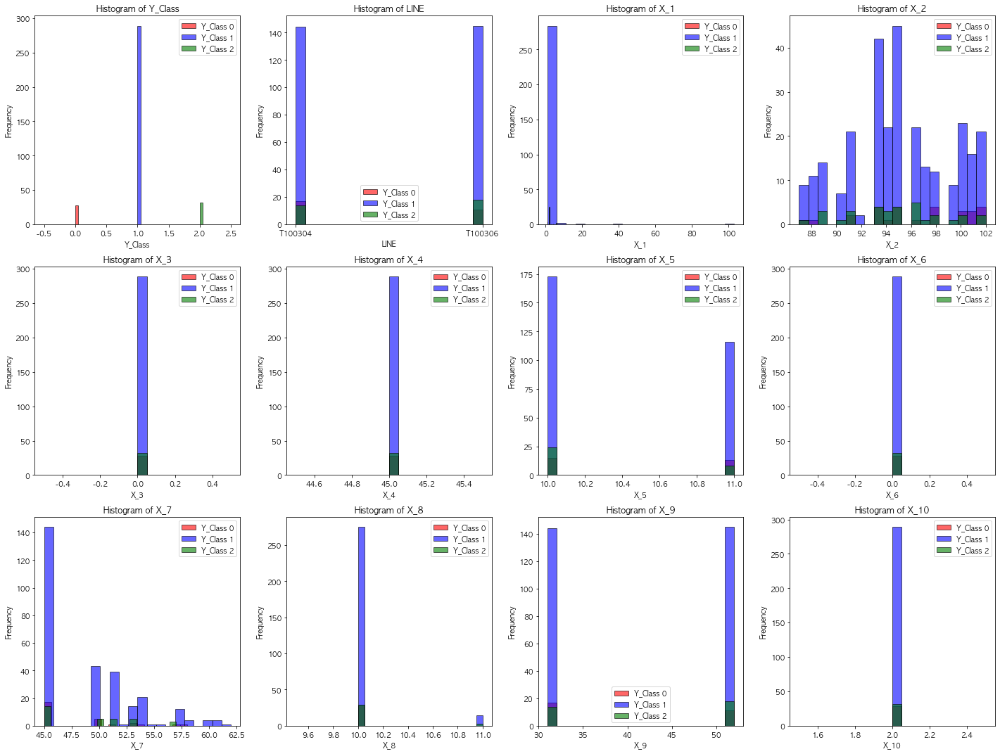

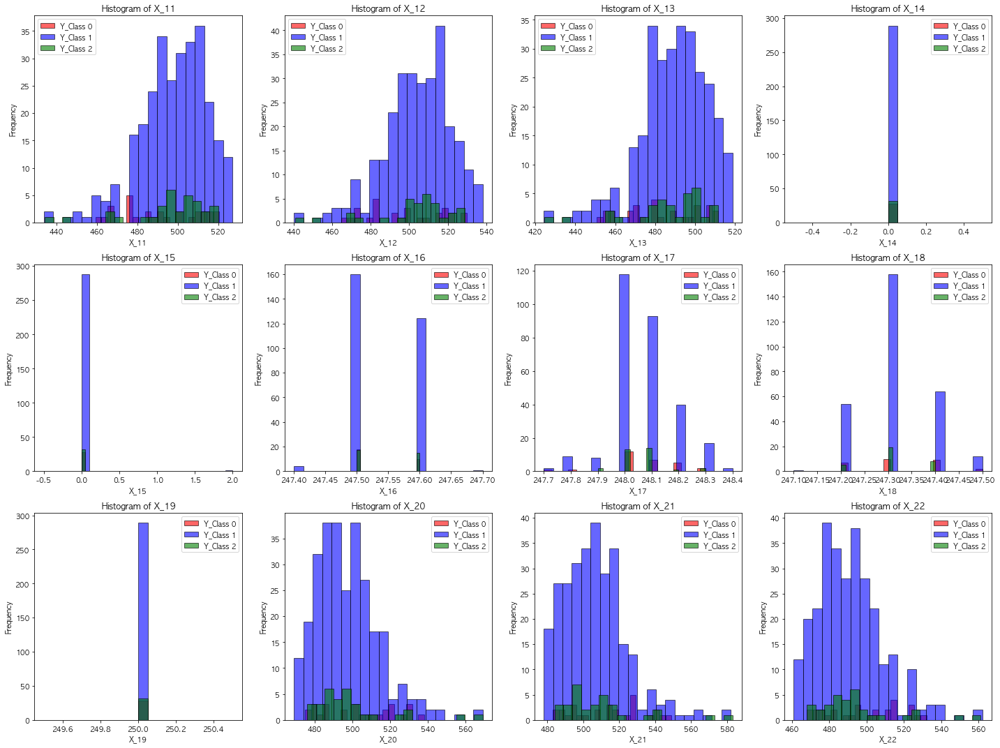

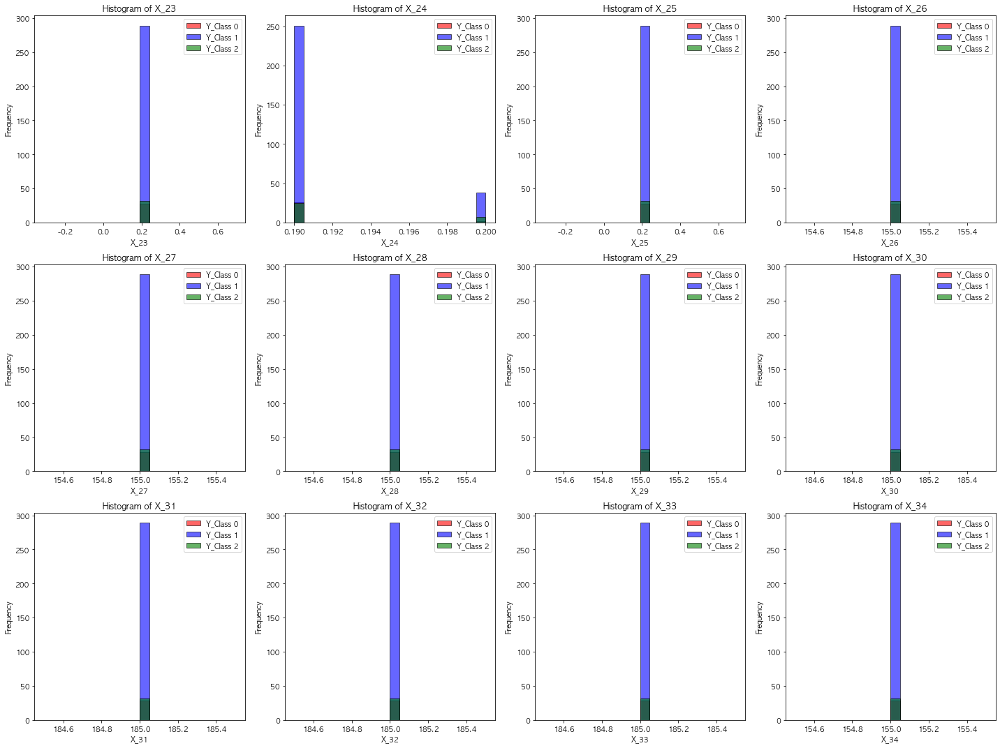

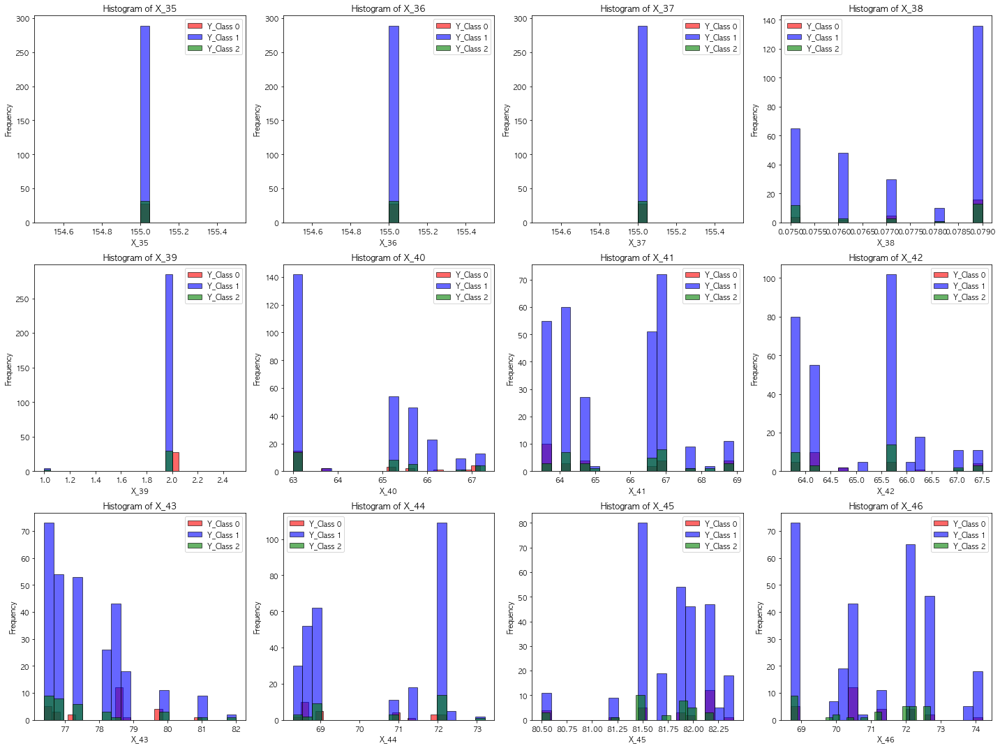

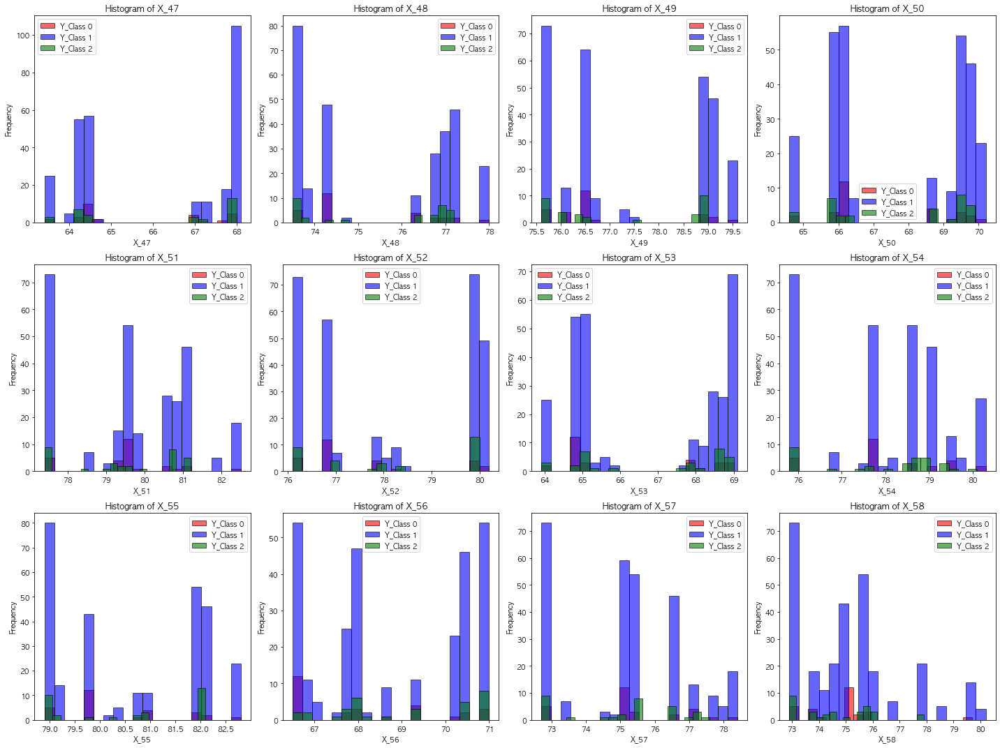

...

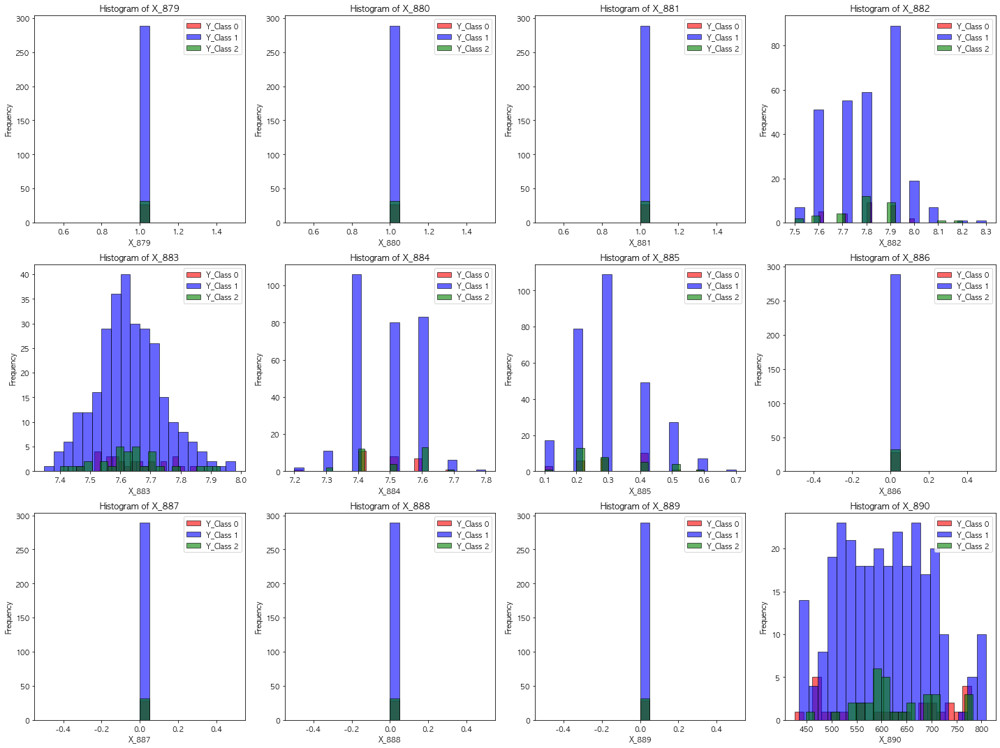

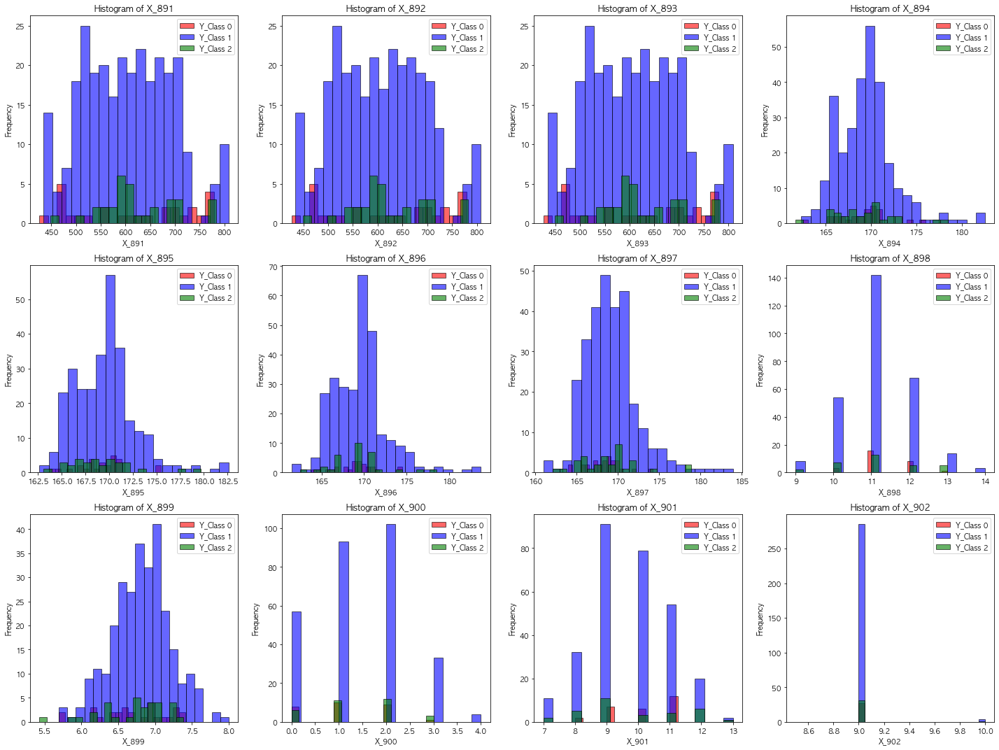

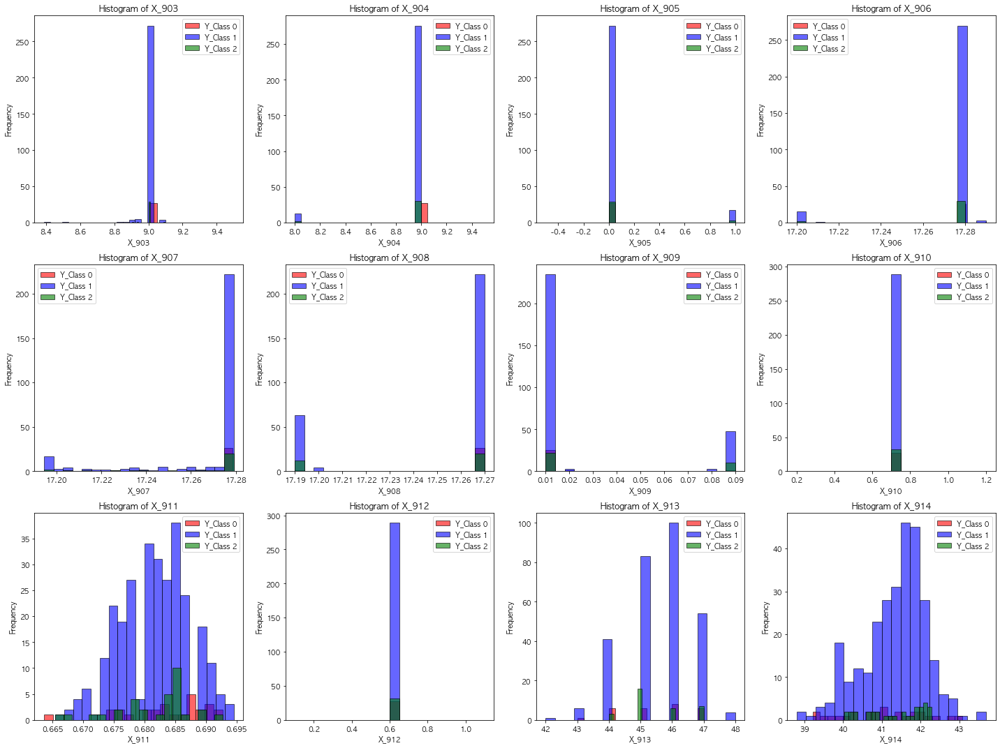

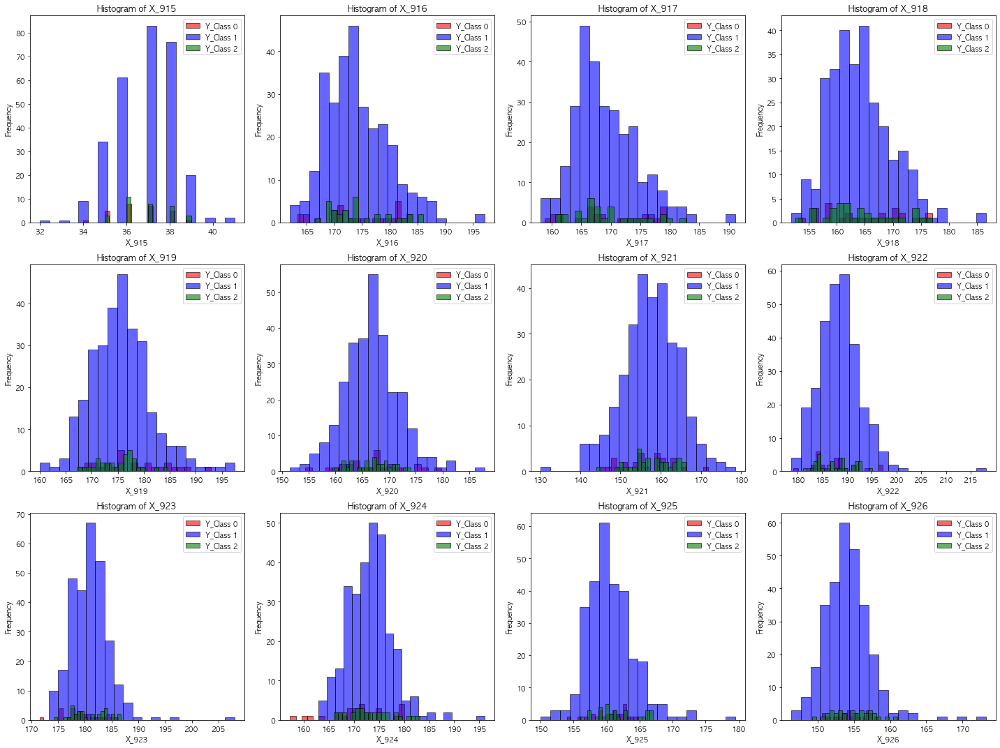

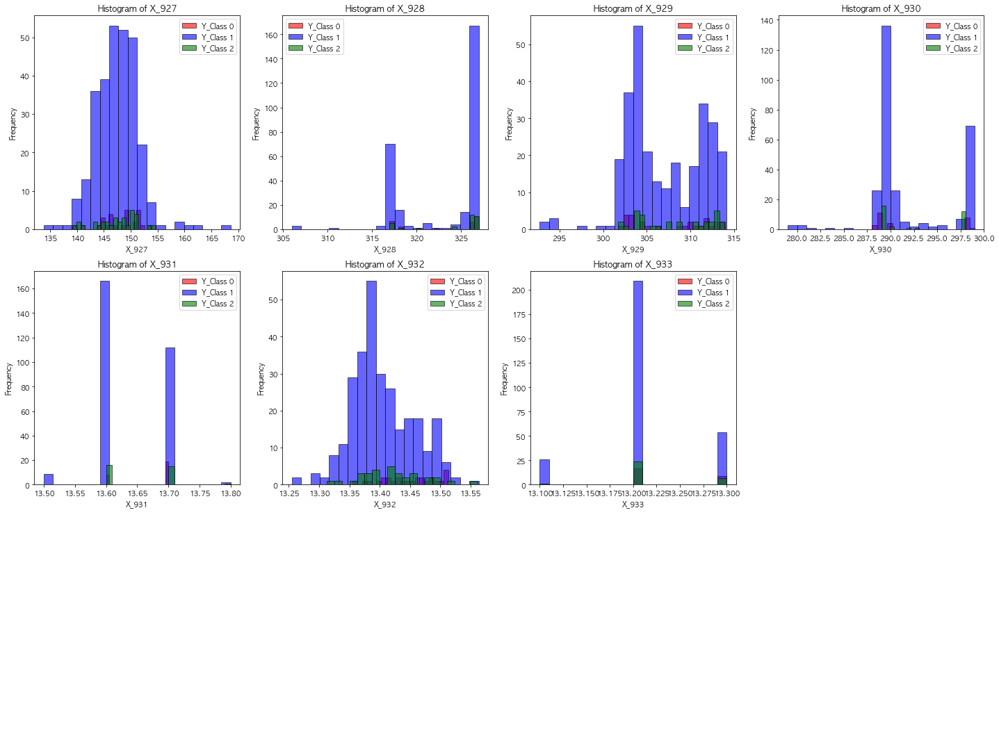

In [41]:
# 12개씩 그리기
columns_per_page = 12
total_columns = len(to_df_nullx.columns)
total_pages = math.ceil(total_columns / columns_per_page)

colors = {0: 'red', 1: 'blue', 2: 'green'}

for page in range(total_pages):
    start_idx = page * columns_per_page
    end_idx = start_idx + columns_per_page
    columns_to_plot = to_df_nullx.columns[start_idx:end_idx]
    
    # 서브플롯
    fig, axs = plt.subplots(3, 4, figsize=(20, 15))
    axs = axs.flatten()
    
    for ax, column in zip(axs, columns_to_plot):
        # Y_Class 별로 히스토그램 생성
        for y_class, color in colors.items():
            subset = to_df_nullx[to_df_nullx['Y_Class'] == y_class]
            ax.hist(subset[column].dropna(), bins=20, color=color, edgecolor='black', alpha=0.6, label=f'Y_Class {y_class}')
        
        ax.set_title(f'Histogram of {column}')
        ax.set_xlabel(column)
        ax.set_ylabel('Frequency')
        ax.legend()
    
    for ax in axs[len(columns_to_plot):]:
        ax.axis('off')
        
    plt.tight_layout()
    plt.show()

### T_31/O_31 제품의 경우 확연히 적합의 비율이 더 높은 것이 보이기 때문에 클래스 불균형을 잘 해결해야 과적합도 막을 수 있을 것이다.